<a href="https://colab.research.google.com/github/Lavanya0707/Netflix-Movies-and-TV-Shows-Clustering/blob/main/NETFLIX_MOVIES_AND_TV_SHOWS_CLUSTERING.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Problem Statement**

This dataset consists of tv shows and movies available on Netflix as of 2019. The dataset is collected from Flixable which is a third-party Netflix search engine.

In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

Integrating this dataset with other external datasets such as IMDB ratings, rotten tomatoes can also provide many interesting findings.

## <b>In this  project, we are required to do </b>
1. Exploratory Data Analysis 

2. Understanding what type content is available in different countries

3. Is Netflix has increasingly focusing on TV rather than movies in recent years.
4. Clustering similar content by matching text-based features



# **Attribute Information**

1. show_id : Unique ID for every Movie / Tv Show

2. type : Identifier - A Movie or TV Show

3. title : Title of the Movie / Tv Show

4. director : Director of the Movie

5. cast : Actors involved in the movie / show

6. country : Country where the movie / show was produced

7. date_added : Date it was added on Netflix

8. release_year : Actual Releaseyear of the movie / show

9. rating : TV Rating of the movie / show

10. duration : Total Duration - in minutes or number of seasons

11. listed_in : Genere

12. description: The Summary description

##### Importing The Required Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import seaborn as sns
import datetime as dt

from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob
import scipy.stats as stats

from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE


%matplotlib inline

##### Import the Dataset From Google Drive Using Pandas

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
data_path = '/content/drive/MyDrive/Colab Notebooks/NETFLIX MOVIES AND TV SHOWS CLUSTERING.csv'
netflix_data = pd.read_csv(data_path)

Mounted at /content/drive


##### Exploring the Data

In [ ]:
# Check the First Five Rows of Data
netflix_data.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,TV Show,3%,NaN,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...


In [ ]:
# Check the Last Five Rows of Data
netflix_data.tail()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
7782,s7783,Movie,Zozo,Josef Fares,"Imad Creidi, Antoinette Turk, Elias Gergi, Car...","Sweden, Czech Republic, United Kingdom, Denmar...","October 19, 2020",2005,TV-MA,99 min,"Dramas, International Movies",When Lebanon's Civil War deprives Zozo of his ...
7783,s7784,Movie,Zubaan,Mozez Singh,"Vicky Kaushal, Sarah-Jane Dias, Raaghav Chanan...",India,"March 2, 2019",2015,TV-14,111 min,"Dramas, International Movies, Music & Musicals",A scrappy but poor boy worms his way into a ty...
7784,s7785,Movie,Zulu Man in Japan,NaN,Nasty C,NaN,"September 25, 2020",2019,TV-MA,44 min,"Documentaries, International Movies, Music & M...","In this documentary, South African rapper Nast..."
7785,s7786,TV Show,Zumbo's Just Desserts,NaN,"Adriano Zumbo, Rachel Khoo",Australia,"October 31, 2020",2019,TV-PG,1 Season,"International TV Shows, Reality TV",Dessert wizard Adriano Zumbo looks for the nex...
7786,s7787,Movie,ZZ TOP: THAT LITTLE OL' BAND FROM TEXAS,Sam Dunn,NaN,"United Kingdom, Canada, United States","March 1, 2020",2019,TV-MA,90 min,"Documentaries, Music & Musicals",This documentary delves into the mystique behi...


In [ ]:
# Check Total Number of rows and Columns in dataset.
print(f' The shape of dataset is ({(netflix_data.shape[0])} x {(netflix_data.shape[1])})\n Total Number of Rows are : {(netflix_data.shape)[0]}\n Total Number of Columns are : {(netflix_data.shape)[1]}')

 The shape of dataset is (7787 x 12)
 Total Number of Rows are : 7787
 Total Number of Columns are : 12


In [ ]:
# List of All Columns in Dataset
pd.DataFrame(netflix_data.columns).T

,0,1,2,3,4,5,6,7,8,9,10,11
0,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description


In [ ]:
# Check the information of Data like Column Names, Missing Values and Data Types using info() function
netflix_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB


In [ ]:
# Check the information of Data like Count, mean Value, Std, Min, 25%, 50%, 75% and Max using Describe() function
netflix_data.describe().T

,count,mean,std,min,25%,50%,75%,max
release_year,7787.0,2013.93258,8.757395,1925.0,2013.0,2017.0,2018.0,2021.0


In [ ]:
# Find the missing value, show the total null values for each column and sort it in descending order
netflix_data.isnull().sum().sort_values(ascending=False)[:10] 

director        2389
cast             718
country          507
date_added        10
rating             7
show_id            0
type               0
title              0
release_year       0
duration           0
dtype: int64

In [ ]:
#print the unique value
pd.DataFrame(netflix_data.nunique()).T

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,7787,2,7787,4049,6831,681,1565,73,14,216,492,7769


In [ ]:
# Checking Duplicate Values
value= netflix_data.duplicated().sum()
print("The Total number of duplicate values in the data set is =",value)

The Total number of duplicate values in the data set is = 0


In [ ]:
# Let's Fix the Missing Value Using fillna() function
netflix_data['director'].fillna('unidentified', inplace=True)
netflix_data['cast'].fillna('unidentified', inplace=True)
netflix_data['country'].fillna('unidentified', inplace=True)
netflix_data['date_added'].fillna('unidentified', inplace=True)
netflix_data['rating'].fillna('unidentified', inplace=True)

In [ ]:
netflix_data.isnull().sum().sort_values(ascending=False)[:10]

show_id         0
type            0
title           0
director        0
cast            0
country         0
date_added      0
release_year    0
rating          0
duration        0
dtype: int64

In [ ]:
# Let's Check The Null Value Fix or Not
netflix_data.tail()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
7782,s7783,Movie,Zozo,Josef Fares,"Imad Creidi, Antoinette Turk, Elias Gergi, Car...","Sweden, Czech Republic, United Kingdom, Denmar...","October 19, 2020",2005,TV-MA,99 min,"Dramas, International Movies",When Lebanon's Civil War deprives Zozo of his ...
7783,s7784,Movie,Zubaan,Mozez Singh,"Vicky Kaushal, Sarah-Jane Dias, Raaghav Chanan...",India,"March 2, 2019",2015,TV-14,111 min,"Dramas, International Movies, Music & Musicals",A scrappy but poor boy worms his way into a ty...
7784,s7785,Movie,Zulu Man in Japan,unidentified,Nasty C,unidentified,"September 25, 2020",2019,TV-MA,44 min,"Documentaries, International Movies, Music & M...","In this documentary, South African rapper Nast..."
7785,s7786,TV Show,Zumbo's Just Desserts,unidentified,"Adriano Zumbo, Rachel Khoo",Australia,"October 31, 2020",2019,TV-PG,1 Season,"International TV Shows, Reality TV",Dessert wizard Adriano Zumbo looks for the nex...
7786,s7787,Movie,ZZ TOP: THAT LITTLE OL' BAND FROM TEXAS,Sam Dunn,unidentified,"United Kingdom, Canada, United States","March 1, 2020",2019,TV-MA,90 min,"Documentaries, Music & Musicals",This documentary delves into the mystique behi...


We see all null values fix in the Dataset

##### Feature Engineering

In [ ]:
# Create a new dataset by using original dataset
new_data = netflix_data.copy()

In [ ]:
new_data['listed_in'] = new_data.listed_in.apply(lambda row: row.split(', '))  # Split Every Value which is containing in Dataset
new_data.explode('listed_in')['listed_in'].unique()

array(['International TV Shows', 'TV Dramas', 'TV Sci-Fi & Fantasy',
       'Dramas', 'International Movies', 'Horror Movies',
       'Action & Adventure', 'Independent Movies', 'Sci-Fi & Fantasy',
       'TV Mysteries', 'Thrillers', 'Crime TV Shows', 'Docuseries',
       'Documentaries', 'Sports Movies', 'Comedies', 'Anime Series',
       'Reality TV', 'TV Comedies', 'Romantic Movies',
       'Romantic TV Shows', 'Science & Nature TV', 'Movies',
       'British TV Shows', 'Korean TV Shows', 'Music & Musicals',
       'LGBTQ Movies', 'Faith & Spirituality', "Kids' TV",
       'TV Action & Adventure', 'Spanish-Language TV Shows',
       'Children & Family Movies', 'TV Shows', 'Classic Movies',
       'Cult Movies', 'TV Horror', 'Stand-Up Comedy & Talk Shows',
       'Teen TV Shows', 'Stand-Up Comedy', 'Anime Features',
       'TV Thrillers', 'Classic & Cult TV'], dtype=object)

In [ ]:
genre_replacing = {'International TV Shows': '-',
                   'TV Dramas': 'Drama',
                   'TV Sci-Fi & Fantasy': 'SciFiFantasy',
                   'Dramas': 'Drama' ,
                   'International Movies': '-',
                   'Horror Movies': 'Horror',
                   'Action & Adventure': 'ActionAdventure',
                   'Independent Movies': '-',
                   'Sci-Fi & Fantasy': 'SciFiFantasy',
                  'TV Mysteries': 'Mystery'       ,
                  'Thrillers': 'Thriller',
                   'Crime TV Shows': 'Crime',
                   'Docuseries': 'Documentary',
                  'Documentaries': 'Documentary', 'Sports Movies': 'Sports',
                   'Comedies':'Comedy',
                   'Anime Series': 'Anime',
                  'Reality TV': 'Reality',
                   'TV Comedies': 'Comedy',
                   'Romantic Movies': 'Romance',
                  'Romantic TV Shows': 'Romance', 
                   'Science & Nature TV': 'Science',
                   'Movies': '-',
                  'British TV Shows': '-',
                   'Korean TV Shows': '-',
                   'Music & Musicals': 'Music',
                  'LGBTQ Movies': 'LGBTQ',
                   'Faith & Spirituality': 'Spirituality', 
                   "Kids' TV": 'Kids',
                  'TV Action & Adventure': 'ActionAdventure',
                   'Spanish-Language TV Shows': '-',
                  'Children & Family Movies': 'Family', 
                   'TV Shows': '-',
                   'Classic Movies': 'Classic',
                  'Cult Movies': 'Cult',
                   'TV Horror': 'Horror',
                   'Stand-Up Comedy & Talk Shows':'Comedy, TalkShow',
                  'Teen TV Shows': 'Teen', 'Stand-Up Comedy':'Comedy', 
                   'Anime Features':'Anime',
                  'TV Thrillers': 'Thriller',
                   'Classic & Cult TV':'Classic, Cult'}

In [ ]:
#create a function to replace genre split it & store in a single list
def replace_gener(row, genre_replacing = genre_replacing):
  new_text = []
 
  for word in (row['listed_in']):
    if word in genre_replacing:
      if '-' not in genre_replacing[word]:
       new_text.append(genre_replacing[word])
    else:
      print(word, 'not present in dictionary')

  return(', '.join(new_text))
  
netflix_data['Genres'] = new_data.apply(lambda row: replace_gener(row),axis=1)
netflix_data['Genres'] = netflix_data['Genres'].apply(lambda row: row.split(', '))
(netflix_data.explode('Genres')['Genres'].unique())

array(['Drama', 'SciFiFantasy', 'Horror', 'ActionAdventure', 'Mystery',
       'Thriller', 'Crime', 'Documentary', 'Sports', 'Comedy', 'Anime',
       'Reality', 'Romance', 'Science', '', 'Music', 'LGBTQ',
       'Spirituality', 'Kids', 'Family', 'Classic', 'Cult', 'TalkShow',
       'Teen'], dtype=object)

##### Converting 'date_added' to datetime format

In [ ]:
import datetime as dt

In [ ]:
def date(row):
  a = row['date_added']
  if 'unidentified' not in a:
    month = a.split()[0]
    year = a.split()[-1]
    day = a.split()[1].split(',')[0]
    a = dt.datetime.strptime(f'{month[:3]} {day} {year}' , '%b %d %Y')
    return a
  else:
    return np.nan

netflix_data['date_added'] = netflix_data.apply(lambda x: date(x), axis=1)


#### Exploratory Data Analysis (EDA)

##### Create a Fuction to Plot the Graph Easily

In [ ]:
# For Easily Ploting Graph we Create a function so we use it directly by just calling the function and Enter value inside it.
# For Ploting Graph we use seaborn and pyplot.
# I'm also use this method for My First Capston Project Which is Hotel Booking Analysis
def plot(x, y, x_label=None,y_label=None, title=None, figsize=(8,5), type='bar'):
    '''
    INPUT Work :
        x-:        Array containing values for x-axis
        y-:        Array containing values for y-axis
        x_lable-:  String value for x-axis label
        y_lable-:  String value for y-axis label
        title-:    String value for plot title
        figsize-:  tuple value, for figure size
        type-:     type of plot (default is bar plot) 
    OUTPUT-:
        Display the plot
    '''
    sns.set_style('darkgrid') ## We call seaborn as sns for set background style in DarkGrid
    
    fig, ax = plt.subplots(figsize=figsize)   
    colors = sns.color_palette('pastel')[0:5]
    
    if x_label != None:
        ax.set_xlabel(x_label)
    
    if y_label != None:
        ax.set_ylabel(y_label)
        
    if title != None:
        ax.set_title(title)
    
    if type == 'bar':
        sns.barplot(x,y, ax = ax)
    elif type == 'line':
        sns.lineplot(x,y, ax = ax)
    elif type == 'pie' :
        plt.pie(y, labels= x ,colors=colors , shadow = True ,autopct='%.0f%%')
  
    plt.show()

In [ ]:
## Another Function for Count the Values (Capturing the values) from the dataset.
def get_count(column, limit=None):  
    '''
    INPUT Work:
        series: Pandas Series (Single Column from DataFrame)
        limit:  If value given, limit the output value to first limit samples.
    OUTPUT:
        x = Unique values
        y = Count of unique values
    '''
    
    if limit != None:
        column = column.value_counts()[:limit]
    else:
        column = column.value_counts()
    
    x = column.index
    y = column/column.sum()*100
    return x.values,y.values

##### Count & Visualise Total Release Movies/Tv shows in Last 10 years

In [ ]:
# Count The Values of Total Release Movies/Tv shows in Last 10 years
netflix_data['release_year'].value_counts()[:10]

2018    1121
2017    1012
2019     996
2016     882
2020     868
2015     541
2014     334
2013     267
2012     219
2010     173
Name: release_year, dtype: int64

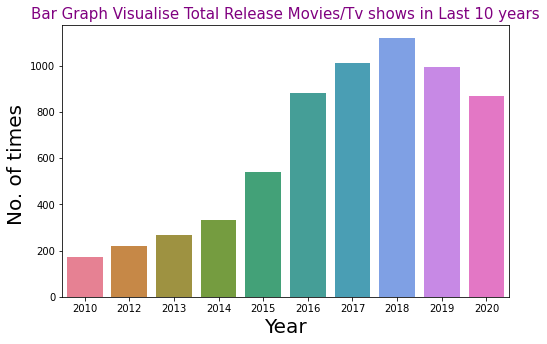

In [ ]:
# Visualise Total Release Movies/Tv shows in Last 10 years
plt.figure(figsize=(8,5)) # set the figure size
sns.barplot(x = netflix_data['release_year'].value_counts()[:10].keys(),
            y = netflix_data['release_year'].value_counts()[:10],
            data = netflix_data,
            palette="husl")
plt.title("Bar Graph Visualise Total Release Movies/Tv shows in Last 10 years" , size=15, c='Purple')
plt.xlabel("Year" , size = 20 )
plt.ylabel("No. of times " , size = 20)
plt.show()

Key Insights
* 2018 is a year where Maximum number of movies have been released which is Total 1121.
* 2017 is a Secound Highest year For Maximum number of movies have been released which is Total 1012.
* 2019 is a Third Highest year where 996 number of movies have been released.

##### Count & Visualise Types of Video on Netflix

In [ ]:
# Count The Values of Total Types of Video on Netflix
netflix_data['type'].value_counts()

Movie      5377
TV Show    2410
Name: type, dtype: int64

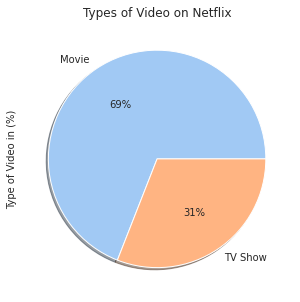

In [ ]:
# Visualisation the Types of Video on Netflix
x,y = get_count(netflix_data['type']) 
plot(x,y, x_label='', y_label='Type of Video in (%)', title='Types of Video on Netflix', type = 'pie')  

Key Insights
* 69% are Movie type of Contents on Netflix which is Total 5377 Number of Movies
* 31% are TV Show type of Contents on Netflix which is Total 2410 Number of TV Shows

##### Count & Visualise the top 10 Countries that produced Highest Number of Movies/Shows on Netflix

In [ ]:
# Count the values of top 10 Countries that produced Highest Number of Movies/Shows on Netflix
list1 = netflix_data[netflix_data.country != 'unknown'].loc[:,['show_id','title','country', 'listed_in']].copy() 
list_country = (list1['country'].to_list())  # To return a list of the value
 
list2 = []  # Empty list to store a splited country value
for country in list_country :
  if ',' in country:
    list1 = country.split(', ')
    list2 = list2 + list1
  else:
    list2.append(country)

country_list = pd.DataFrame({'country' : list2, 'id':np.arange(0,len(list2),1)})
list1 = country_list.groupby('country').agg({'id':'count'}).sort_values('id', ascending= False).head(20).reset_index() #Final Country list
list1.T


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
country,United States,India,United Kingdom,unidentified,Canada,France,Japan,Spain,South Korea,Germany,Mexico,China,Australia,Egypt,Turkey,Hong Kong,Italy,Brazil,Taiwan,Belgium
id,3296,990,722,507,412,349,287,215,212,199,154,147,144,110,108,102,90,88,85,85


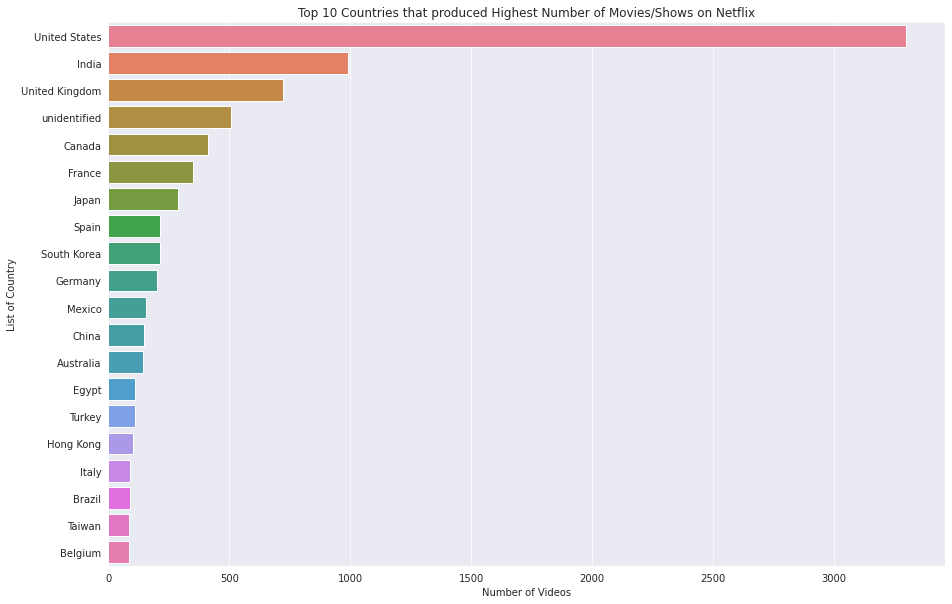

In [ ]:
# Visualise the Top 10 Countries that produced Highest Number of Movies/Shows on Netflix
plt.figure(figsize=(15,10))
list1 = sns.barplot(y = 'country', x = 'id',data = list1 , palette='husl')
list1 = plt.title('Top 10 Countries that produced Highest Number of Movies/Shows on Netflix') # Set the Graph Title
list1 = plt.ylabel('List of Country') # Set a Y Label
list1 = plt.xlabel('Number of Videos') # Set a X Label
top10countries = country_list.groupby('country').agg({'id':'count'}).sort_values('id', ascending= False).head(10).reset_index()['country'].unique()

Key Insights
* United State is a Country which is produced Highest Number of Movies/Shows on Netflix. Total Number of Movies/Show produced by US is 3296.
* India is a Second Highest Country which is produced Highest Number of Movies/Shows on Netflix. Total Number of Movies/Show produced by India is 990.
* United Kingdom is a Third Highest Country which is produced Highest Number of Movies/Shows on Netflix. Total Number of Movies/Show produced by US is 722.

##### Count & Visualize Top 5 Rating Distribution for Movies and Shows on Netflix

In [ ]:
# Count The Values of Top 5 Rating Distribution for Movies and Shows on Netflix
netflix_data['rating'].value_counts()[:5]

TV-MA    2863
TV-14    1931
TV-PG     806
R         665
PG-13     386
Name: rating, dtype: int64

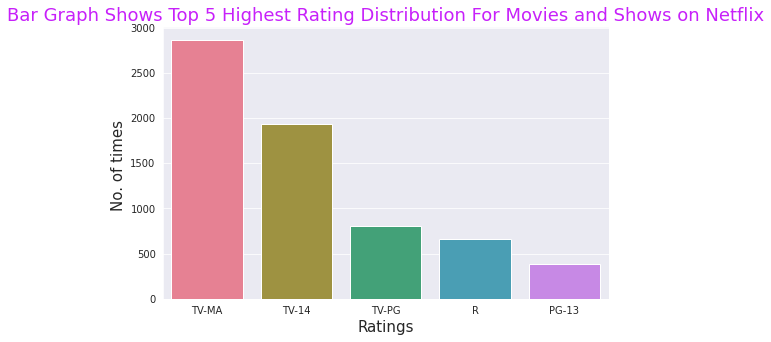

In [ ]:
# Visualise Top 5 Rating Distribution of Movies and Shows on Netflix
plt.figure(figsize=(8,5))
sns.barplot(x = netflix_data['rating'].value_counts()[:5].keys(),
            y = netflix_data['rating'].value_counts()[:5],
            data = netflix_data,
            palette="husl")
plt.title("Bar Graph Shows Top 5 Highest Rating Distribution For Movies and Shows on Netflix", size=18, c='#c720fa')
plt.xlabel("Ratings" , size = 15 )
plt.ylabel("No. of times " , size = 15 )
plt.show()

Key Insights
* Tv-MA is a Highest Rating Distribution For Movies and Shows on Netflix, which is Total 2863
* Tv-14 is a Secound Highest Rating Distribution For Movies and Shows on Netflix, which is Total 1931
* Tv-PG is a Third Highest Rating Distribution For Movies and Shows on Netflix, which is Total 806

##### Count & Visualise the top Genres For Movies/TV-Shows on Netflix

In [ ]:
# Count the values of Genres For Movies/TV Shows
genres = netflix_data.loc[:,['show_id','title','country', 'Genres']].copy()
genres = genres.explode('Genres')
genre_list = genres.Genres.unique() 
genre_count = genres.groupby('Genres').agg(count = ('show_id','count')).sort_values('count', ascending= False).reset_index()  #use groupby function to add all genres in a single variable
top15genres = genre_count.head(15)['Genres'].to_list()
genre_count.T

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Genres,Drama,Comedy,Documentary,ActionAdventure,Romance,Thriller,Family,Crime,Kids,Horror,...,Sports,Classic,LGBTQ,Mystery,Cult,Science,,Teen,Spirituality,TalkShow
count,2810,2377,1139,871,864,541,532,427,414,381,...,196,130,90,90,86,85,74,60,57,52


Text(0, 0.5, 'Genres')

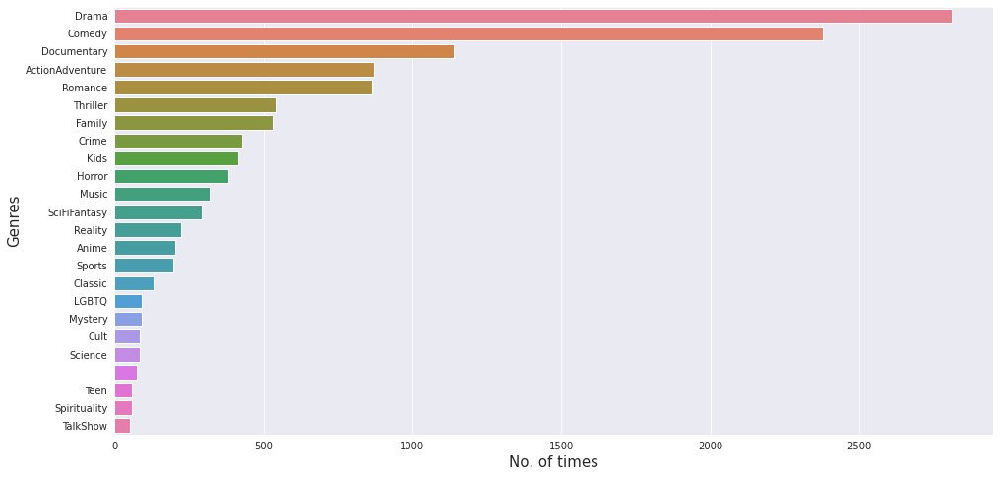

In [ ]:
# Visualise the Top Genres For Movies/TV Shows on Netflix
plt.figure(figsize=(16,8))  # Set Figure Size 
sns.barplot(y = 'Genres', x = 'count',data = genre_count , palette='husl')  # Use Barplot to Visualise the data with husl color palette
plt.xlabel("No. of times" , size = 15 ) # Set a xlabel 
plt.ylabel("Genres" , size = 15 ) # Set a ylabel 

Key Insights
* Drama is a Top Genres For Movies/TV Shows on Netflix. That is, the content of the movie in the drama genre has been produced the most which is 2810 Times.
* Comedy is a Secound Highest Genres For Movies/TV Shows on Netflix which is 2377 Times.
* Documentary is a Third Highest Genres For Movies/TV Shows on Netflix which is 1139 Times.
* Action_Adventure are in 4th Position & Romance are in 5th Position.

##### Count & Visualise the Top Directores on Netflix

In [ ]:
Count=netflix_data[netflix_data.director != 'unidentified'].loc[:,['show_id','title','director', 'cast']].copy()
director = (Count['director'].to_list())

newlist = []
for genre in director:
  if ',' in genre:
    Count = genre.split(', ')
    newlist = newlist + Count
  else:
    newlist.append(genre)
country_list = pd.DataFrame({'Director' : newlist, 'id':np.arange(0,len(newlist),1)})
Count = country_list.groupby('Director').agg({'id':'count'}).sort_values('id', ascending= False).reset_index().head(15)
Count.T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
Director,Jan Suter,Raúl Campos,Marcus Raboy,Jay Karas,Cathy Garcia-Molina,Martin Scorsese,Jay Chapman,Youssef Chahine,Steven Spielberg,David Dhawan,Anurag Kashyap,Shannon Hartman,Ryan Polito,Robert Rodriguez,Umesh Mehra
id,21,19,16,15,13,12,12,12,10,9,9,9,8,8,8


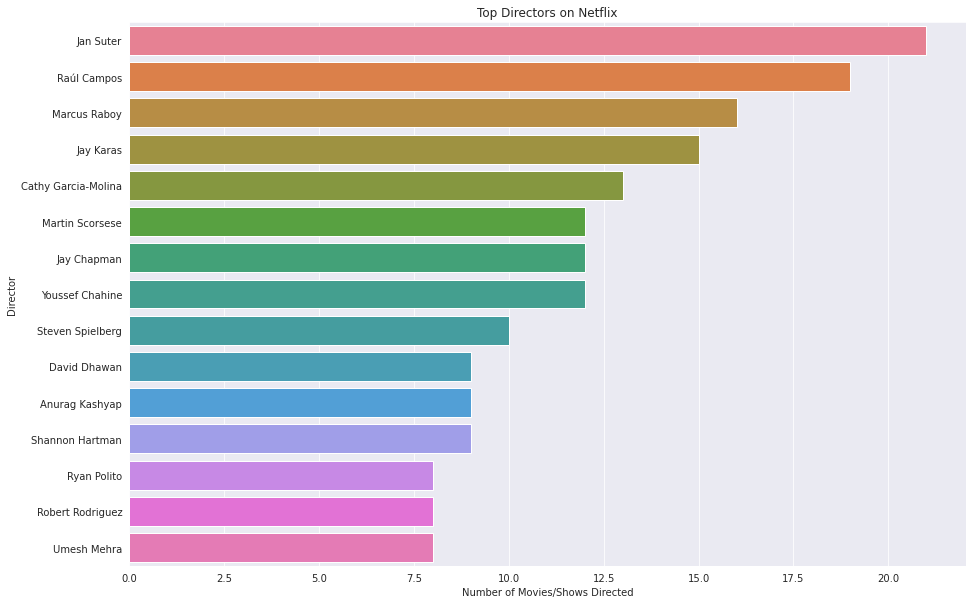

In [ ]:
plt.figure(figsize=(15,10))
sns.barplot(y = 'Director', x = 'id',data = Count , palette= 'husl')
plt.title('Top Directors on Netflix')
plt.ylabel('Director')
plt.xlabel('Number of Movies/Shows Directed')
topdirectorslist = country_list.groupby('Director').agg({'id':'count'}).sort_values('id', ascending= False).reset_index().head(10)['Director'].to_list()

Key Insights
* Jan Suter is the top director in the Netflix industry & he has Directed 21 Movies/Shows.
* Raul Compose is the Second top director in the Netflix industry & he has Directed 19 Movies/Shows.
* Marcus Raboy is the Third top director in the Netflix industry & he has Directed 16 Movies/Shows.
* Jay Karas is the 4th position & he has Directed 15 Movies/Shows and Cathy Garcia-Molina is the 5th Position & he has Directed 13 Movies/Shows.

##### Count & Visualise the Top cast on Netflix Till Year of 2020

In [ ]:
count=netflix_data[netflix_data.cast != 'unidentified'].loc[:,['show_id','title','director', 'cast']].copy()
cast = (count['cast'].to_list())

newlist = []
for genre in cast:
  if ',' in genre:
    count = genre.split(', ')
    newlist = newlist + count
  else:
    newlist.append(genre)
country_list = pd.DataFrame({'Actor' : newlist, 'id':np.arange(0,len(newlist),1)})
count = country_list.groupby('Actor').agg({'id':'count'}).sort_values('id', ascending= False).head(20).reset_index()
count.T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
Actor,Anupam Kher,Shah Rukh Khan,Naseeruddin Shah,Om Puri,Akshay Kumar,Takahiro Sakurai,Paresh Rawal,Amitabh Bachchan,Yuki Kaji,Boman Irani,Kareena Kapoor,John Cleese,Andrea Libman,Vincent Tong,Ashleigh Ball,Tara Strong,Ajay Devgn,Nawazuddin Siddiqui,Nicolas Cage,Salman Khan
id,42,35,30,30,29,29,27,27,27,27,25,24,24,24,22,22,21,21,20,20


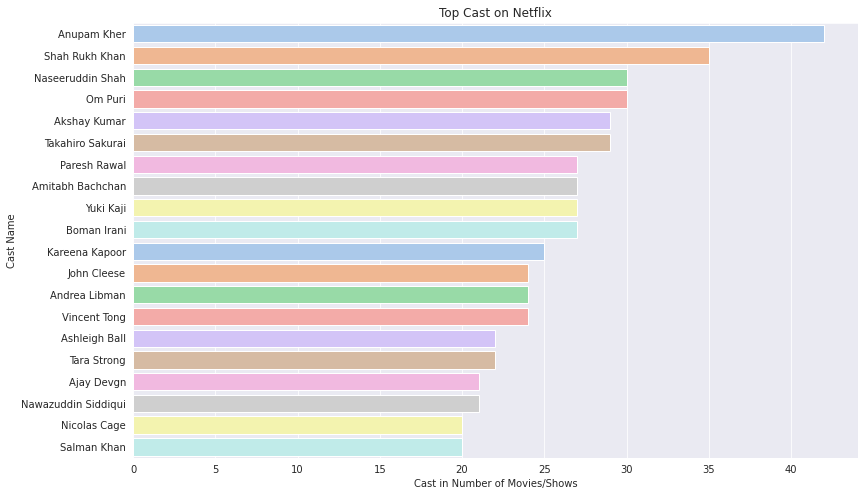

In [ ]:
plt.figure(figsize=(13,8))
sns.barplot(y = 'Actor', x = 'id', data = count , palette= 'pastel')
plt.title('Top Cast on Netflix')
plt.ylabel('Cast Name')
plt.xlabel('Cast in Number of Movies/Shows')
top10actors = country_list.groupby('Actor').agg({'id':'count'}).sort_values('id', ascending= False).head(20).reset_index()['Actor'].to_list()

Key Insights
* Anupam Kher is the Top Cast on Netflix As Our Visualisation
* Shah Rukh Khan is the second highest cast on Netflix 
* Naseeruddin Shah is the third highest cast on Netflix 
* Om Puri is the 4th Highest cast on Netflix
* Akshay Kumar is the 5th Highest cast on Netflix

##### Top Duration of Movies on Netflix

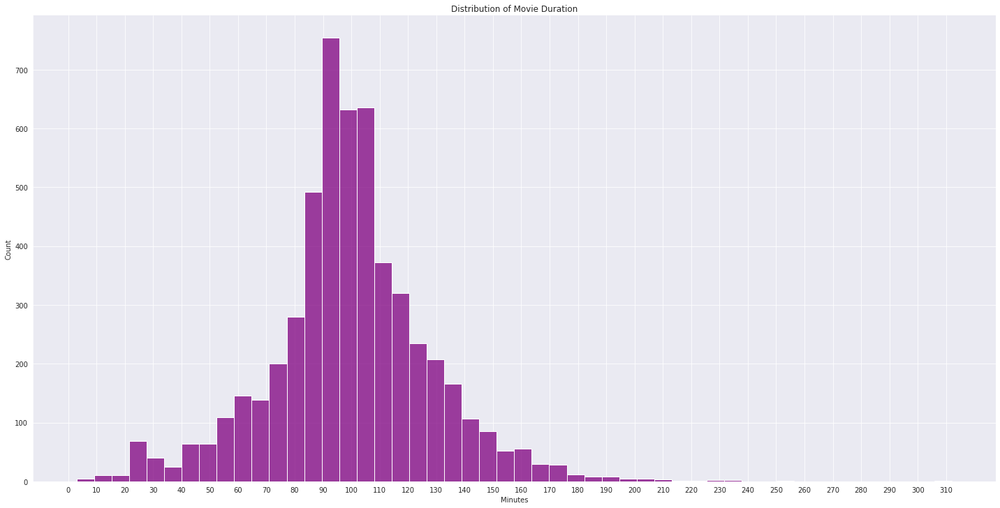

In [ ]:
count=netflix_data[netflix_data['type']=='Movie'].loc[:,['show_id','duration']].copy()
cast = (count['duration'].to_list())

newlist = [] 
for genre in cast: 
  newlist.append(int(genre.split(' ')[0])) 
country_list = pd.DataFrame({'Duration' : newlist, 'id':np.arange(0,len(newlist),1)}) 
count = sns.displot(x= 'Duration',  data = country_list, kind = 'hist', height=10, aspect=2, bins = 50, color='purple') 
count = plt.title('Distribution of Movie Duration') 
count = plt.xlabel('Minutes') 
count = plt.xticks(ticks = np.arange(0,country_list.Duration.max()+1,10)) 

Key Insights
* Most of the movies on Netflix have a duration range from 85 to 115 minutes.

##### Highest Duration of TV Shows on Netflix

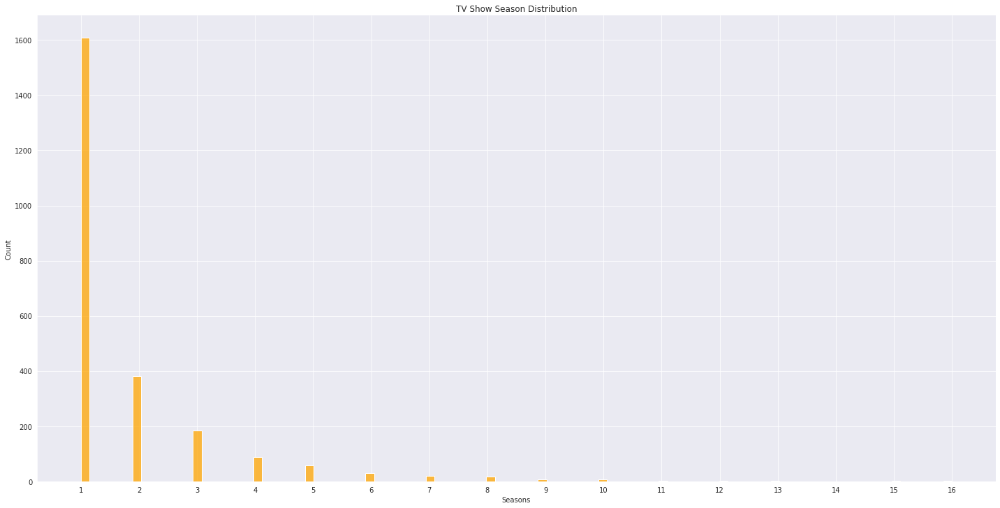

In [ ]:
count=netflix_data[netflix_data['type']!='Movie'].loc[:,['show_id','duration']].copy()
cast = (count['duration'].to_list())

newlist = []
for genre in cast:
  newlist.append(int(genre.split(' ')[0]))
country_list = pd.DataFrame({'Seasons' : newlist, 'id':np.arange(0,len(newlist),1)})
count = sns.displot(x= 'Seasons',  data = country_list, kind = 'hist', height=10, aspect=2, color='orange')
count = plt.title('TV Show Season Distribution')
count = plt.xlabel('Seasons')
count = plt.xticks(ticks = np.arange(country_list.Seasons.min(),country_list.Seasons.max()+1,1))

Key Insights
* Most TV shows on Netflix have a length of 1 season only.

##### Check the What type content is available in different countries

Text(0, 0.5, 'Total Number of Movies/Shows')

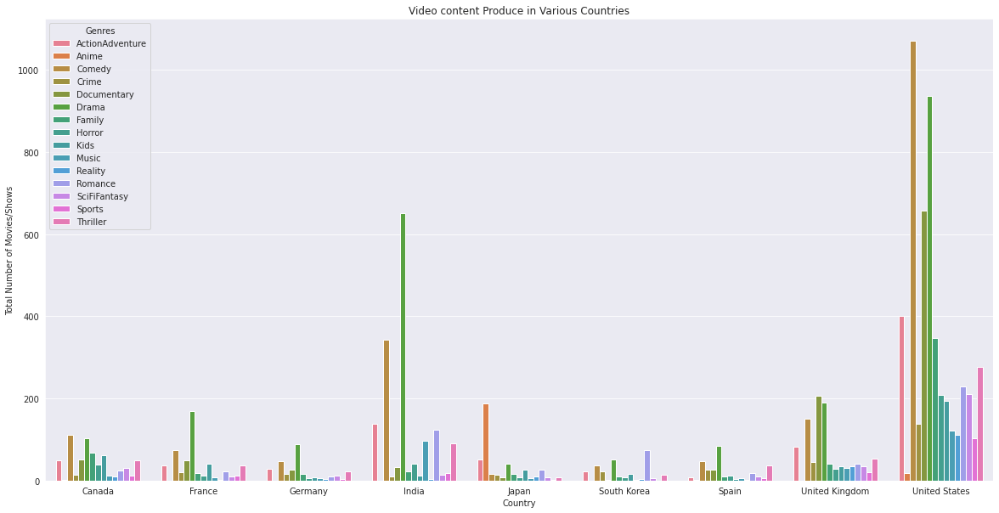

In [ ]:
new_data = netflix_data[netflix_data['country'] != 'unidentified'].loc[:,['show_id','title','country','listed_in','Genres']].copy()


#function to convert string type to list 
def operation(row,string):
  return row[string].split(', ')
new_data['listed_in'] = new_data.apply(lambda x: operation(x,'listed_in'), axis = 1)
new_data['country'] = new_data.apply(lambda x: operation(x,'country'), axis = 1)


#explodes the list of categories and genres in each row to individual rows
new_data = new_data.explode('Genres').explode('country')
new_data = new_data.groupby(['country','Genres']).agg({'show_id':'count'}).reset_index() #table contains number of videos belonging to each genre from different countries


#function to return the indeces that contain the top10 countries with the top 10 genres viewed
def selectindex(row, attribute, list):
  b = row[attribute]
  boolean = b in list
  return boolean

index = new_data.apply(lambda x: selectindex(x, 'country',top10countries), axis = 1)
newindex = new_data[index].apply(lambda x: selectindex(x, 'Genres',top15genres), axis = 1)
newdata = new_data[index][newindex] #data that contains the number videos in the top 15 genres in the top 10 countries
palette = ['#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff',
 '#000000','#ff0000','#0000ff','#556b2f']
new_data = plt.figure(figsize=(20,10))
sns.barplot(x = newdata['country'], y = newdata['show_id'], hue = newdata['Genres'], palette= "husl" )
plt.title('Video content Produce in Various Countries')
plt.xlabel('Country')
plt.ylabel('Total Number of Movies/Shows') 

Key Insights

* Drama is the most produced genre in a lot of Non-English speaking countries
* Comedy is the most produced genre in English speaking countries like United States of America and United Kingdom and Canada
* Drama and Comedy are the most produced genres in the top countries with exceptions of Japan and South Korea
* Japan is the biggest producer of Anime. Anime is also the most produced in genre in Japan
* Most South Korean content are from the Romance genre

* Documentaries are mainly produced in United Kingdom and United States of America


##### Is Netflix has increasingly focusing on TV rather than movies in recent years ?

In [ ]:
content = netflix_data.loc[:,['title','date_added','release_year', 'duration', 'type']].dropna().copy()
content['date_added'] = content['date_added'].dt.year

# Create a function that check the season
def season(row):
  release = row['release_year']
  added = row['date_added']

  if row['type'] =='TV Show':
    seasons = int(row['duration'][0])
    b = []
    for i in range(1, seasons+1):
      if i ==1:
        b.append(release)
      else:
        b.append(b[-1]-1)
    a = b
  else:
    a = []
    a.append(row['release_year'])      
  
  return a

content['Released Years'] = content.apply(lambda x: season(x),axis=1)

Text(0, 0.5, 'Number of TV. Seasons/Movies Signed')

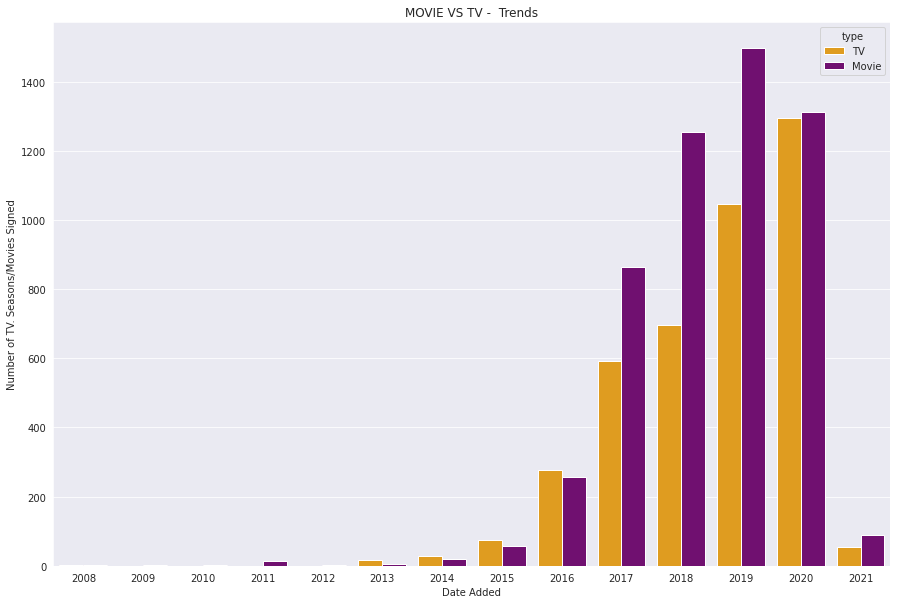

In [ ]:
compare = content.explode('Released Years')
tv = compare[compare['type'] == 'TV Show'].groupby(['date_added']).agg(count = ('title','count')).reset_index()
tv['type'] = 'TV'
movie = compare[compare['type'] != 'TV Show'].groupby(['date_added']).agg(count = ('title','count')).reset_index()
movie['type'] = 'Movie'

movie_data = pd.concat([tv, movie], axis = 0)

# Visualisation of is Netflix has increasingly focusing on TV rather than movies in recent years ?
plt.figure(figsize = (15,10))
sns.barplot(x = 'date_added', y='count', hue = 'type', data = movie_data , palette=["orange", "purple"])
plt.title('MOVIE VS TV -  Trends')
plt.xlabel('Date Added')
plt.ylabel('Number of TV. Seasons/Movies Signed')


Key Insights
* The above graph depicts seasons of TV shows signed vs the movies signed.
* This distinction gives contacts as TV shows require recurring investment for each seasons. So the TV numbers have been increased in accordance to the seasons. As they were considered as one entity earlier.        
* We can observe that TV shows signed have been higher than movies in 2016. While the the movies signed have been higher, it is blatantly visible that the TV shows signed per year is catching up to the movies signed by the year



#### Machine Learning Text Processing

It is the process of obtaining valuable insights from texts.This method also use for detect different patterns in data and break the text into clusters. We convert all text to lower case, remove punctuations as well as remove irrelevant words. Here similar words are unified to save memory and processing time as well. Individual words and group of words are also collected to extract context related details.

##### Feature Engineering to " listed_in " column

In [ ]:
new_data = netflix_data.copy()


new_data['listed_in'] = new_data.listed_in.apply(lambda row: row.split(', '))
new_data.explode('listed_in')['listed_in'].unique()

array(['International TV Shows', 'TV Dramas', 'TV Sci-Fi & Fantasy',
       'Dramas', 'International Movies', 'Horror Movies',
       'Action & Adventure', 'Independent Movies', 'Sci-Fi & Fantasy',
       'TV Mysteries', 'Thrillers', 'Crime TV Shows', 'Docuseries',
       'Documentaries', 'Sports Movies', 'Comedies', 'Anime Series',
       'Reality TV', 'TV Comedies', 'Romantic Movies',
       'Romantic TV Shows', 'Science & Nature TV', 'Movies',
       'British TV Shows', 'Korean TV Shows', 'Music & Musicals',
       'LGBTQ Movies', 'Faith & Spirituality', "Kids' TV",
       'TV Action & Adventure', 'Spanish-Language TV Shows',
       'Children & Family Movies', 'TV Shows', 'Classic Movies',
       'Cult Movies', 'TV Horror', 'Stand-Up Comedy & Talk Shows',
       'Teen TV Shows', 'Stand-Up Comedy', 'Anime Features',
       'TV Thrillers', 'Classic & Cult TV'], dtype=object)

In [ ]:
replacing_genre = {'International TV Shows': '-',
                   'TV Dramas': 'Drama',
                   'TV Sci-Fi & Fantasy': 'SciFiFantasy',
                   'Dramas': 'Drama' ,
                   'International Movies': '-',
                   'Horror Movies': 'Horror',
                   'Action & Adventure': 'ActionAdventure',
                   'Independent Movies': '-',
                   'Sci-Fi & Fantasy': 'SciFiFantasy',
                  'TV Mysteries': 'Mystery'       ,
                  'Thrillers': 'Thriller',
                   'Crime TV Shows': 'Crime',
                   'Docuseries': 'Documentary',
                  'Documentaries': 'Documentary', 'Sports Movies': 'Sports',
                   'Comedies':'Comedy',
                   'Anime Series': 'Anime',
                  'Reality TV': 'Reality',
                   'TV Comedies': 'Comedy',
                   'Romantic Movies': 'Romance',
                  'Romantic TV Shows': 'Romance', 
                   'Science & Nature TV': 'Science',
                   'Movies': '-',
                  'British TV Shows': '-',
                   'Korean TV Shows': '-',
                   'Music & Musicals': 'Music',
                  'LGBTQ Movies': 'LGBTQ',
                   'Faith & Spirituality': 'Spirituality', 
                   "Kids' TV": 'Kids',
                  'TV Action & Adventure': 'ActionAdventure',
                   'Spanish-Language TV Shows': '-',
                  'Children & Family Movies': 'Family', 
                   'TV Shows': '-',
                   'Classic Movies': 'Classic',
                  'Cult Movies': 'Cult',
                   'TV Horror': 'Horror',
                   'Stand-Up Comedy & Talk Shows':'Comedy, TalkShow',
                  'Teen TV Shows': 'Teen', 'Stand-Up Comedy':'Comedy', 
                   'Anime Features':'Anime',
                  'TV Thrillers': 'Thriller',
                   'Classic & Cult TV':'Classic, Cult'}

In [ ]:
def replace_genre(row, replacing_genre = replacing_genre):
  new_text = []
 
  for word in (row['listed_in']):
    if word in replacing_genre:
      if '-' not in replacing_genre[word]:
       new_text.append(replacing_genre[word])
    else:
      print(word, 'not present in dictionary')

  return(', '.join(new_text))
  

netflix_data['Genres'] = new_data.apply(lambda row: replace_genre(row),axis=1)
netflix_data['Genres'] = netflix_data['Genres'].apply(lambda row: row.split(', '))

(netflix_data.explode('Genres')['Genres'].unique())

array(['Drama', 'SciFiFantasy', 'Horror', 'ActionAdventure', 'Mystery',
       'Thriller', 'Crime', 'Documentary', 'Sports', 'Comedy', 'Anime',
       'Reality', 'Romance', 'Science', '', 'Music', 'LGBTQ',
       'Spirituality', 'Kids', 'Family', 'Classic', 'Cult', 'TalkShow',
       'Teen'], dtype=object)

In [ ]:
netflix_data['Genres']

0                 [Drama, SciFiFantasy]
1                               [Drama]
2                              [Horror]
3       [ActionAdventure, SciFiFantasy]
4                               [Drama]
                     ...               
7782                            [Drama]
7783                     [Drama, Music]
7784               [Documentary, Music]
7785                          [Reality]
7786               [Documentary, Music]
Name: Genres, Length: 7787, dtype: object

##### Combine the Top CAST, DIRECTOR and ListedIn into single text attributes

In [ ]:
def combine(row):
  text = ' '.join(row['Genres']).lower()
  if row['cast'] != 'unidentified':
    cast_list = [actor.replace(' ', '') for actor in row['cast'].split(', ')]
    if len(cast_list) < 5:
      text = text + ' ' + ' '.join(cast_list[:]).lower()
    else :
      text = text + ' ' + ' '.join(cast_list[:5]).lower()
  if row['director'] !='unidentified':
    director_list = ' '.join([director.replace(' ', '') for director in row['director'].split(', ')])
    text = text + ' ' + director_list.lower()

  return text
netflix_data['Movie Deets'] = netflix_data.apply(lambda row: combine(row), axis = 1)


netflix_data.head()['Movie Deets'].to_list()

['drama scififantasy joãomiguel biancacomparato michelgomes rodolfovalente vanezaoliveira',
 'drama demiánbichir héctorbonilla oscarserrano azaliaortiz octaviomichel jorgemichelgrau',
 'horror teddchan stellachung henleyhii lawrencekoh tommykuan gilbertchan',
 'actionadventure scififantasy elijahwood johnc.reilly jenniferconnelly christopherplummer crispinglover shaneacker',
 'drama jimsturgess kevinspacey katebosworth aaronyoo lizalapira robertluketic']

In [ ]:
#importing Required libraries for performing text processing
import nltk 
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string 
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
 nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

##### Word Tokenization

Tokenization breaks the raw text into words, sentences called tokens. These tokens help in understanding the context or developing the model for the NLP. The tokenization helps in interpreting the meaning of the text by analyzing the sequence of the words.

In [ ]:
import string

In [ ]:
def tokenization(txt):  
  tokens = word_tokenize(txt) 
  return tokens
  
netflix_data['Processed Description'] = netflix_data['description'].apply(tokenization)
netflix_data['Processed Movie Deets'] = netflix_data['Movie Deets'].apply(tokenization)

##### Punctuation Removal Code

In [ ]:
regular_punct = list(string.punctuation)
def remove_punctuation(text,punct_list):
  tokens = text
  new_tok = []
  for i in tokens:
    word = i
    for punctuation in list(string.punctuation):
      word = word.replace(punctuation, ' ')
    if word.replace(' ','').isalnum():
      new_tok.append(word)

  return ' '.join(new_tok).split(' ')

netflix_data['Processed Description'] = netflix_data['Processed Description'].apply(lambda x : remove_punctuation(x, regular_punct))
netflix_data['Processed Movie Deets'] = netflix_data['Processed Movie Deets'].apply(lambda x : remove_punctuation(x, regular_punct))

##### Stop Word Removal

In [ ]:
stop_word = set(stopwords.words('english')) 

def remove_stop(tokens, stopwords):
  return [t.lower() for t in tokens if t.lower() not in stopwords]

netflix_data['Processed Description'] = netflix_data['Processed Description'].apply(lambda x : remove_stop(x, stop_word))

new_data = netflix_data.copy() #will be used for wordcloud later on

##### Stemming

Stemming is the process of reducing a word to its word stem that affixes to suffixes and prefixes or to the roots of words known as a lemma.

In [ ]:
ps = PorterStemmer()

def stem_text(text):  
  stemmed = []
  for word in text:
    stemmed.append(ps.stem(word))
  return stemmed

netflix_data['Processed Description'] = netflix_data['Processed Description'] .apply(lambda x : stem_text(x))

In [ ]:
def joiner(text_list):
  new = []
  for text in text_list:
    if text == ' ' or text == '' :
      pass
    else:
      new.append(text)
      
  return ' '.join(new)

netflix_data['Processed Description'] = netflix_data['Processed Description'] .apply(lambda x : joiner(x))
netflix_data['Processed Movie Deets'] = netflix_data['Processed Movie Deets'].apply(lambda x : joiner(x))

In [ ]:
netflix_data.loc[:,['description','Processed Description','Movie Deets','Processed Movie Deets']].head(1).T

,0
description,In a future where the elite inhabit an island ...
Processed Description,futur elit inhabit island paradis far crowd sl...
Movie Deets,drama scififantasy joãomiguel biancacomparato ...
Processed Movie Deets,drama scififantasy joãomiguel biancacomparato ...


##### Vectorizing Texts

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

vectorizer_count = CountVectorizer(min_df = 10,max_df=0.5)
description_vector_count = vectorizer_count.fit_transform(netflix_data['Processed Description'])

movie_vector_count = vectorizer_count.fit_transform(netflix_data['Processed Movie Deets'])

In [ ]:
description_vector_count.shape

(7787, 2126)

In [ ]:
movie_vector_count.shape

(7787, 192)

In [ ]:
from sklearn.decomposition import PCA
pca = PCA()
pca.fit(pd.concat([pd.DataFrame(description_vector_count.todense()), pd.DataFrame(movie_vector_count.todense())],axis =1))

PCA()

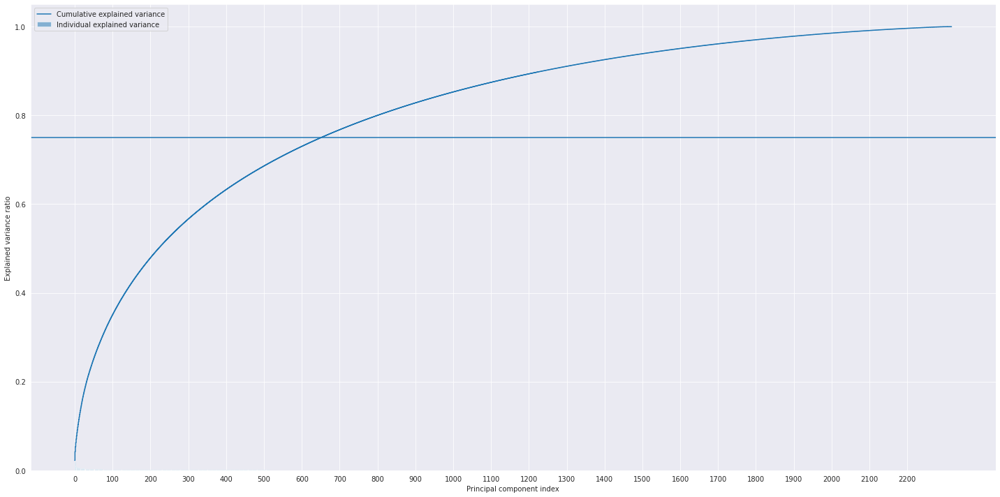

In [ ]:
exp_var_pca = pca.explained_variance_ratio_
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
# Create the visualization plot
plt.figure(figsize = (20,10))
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.xticks(ticks = np.arange(0,2300,100))
plt.axhline(y=0.75)
plt.show()

Vectorising the preprocessed attributes Movie Deets and Description has sum total of 2126 + 192 = 2318 dimensions. These dimensions will have to be reduced using PCA, which would result in loss of information. Alternatively, the two attributes can be used to model the content into topics using Latent Dirichlet Allocation. This would makes sure that all the topical information about video content are captured without putting any available information to waste.

##### Bag of words wordcloud generation of content description Based on Genre

In [ ]:
from wordcloud import WordCloud

In [ ]:
genres = netflix_data.explode('Genres').Genres.unique()

In [ ]:
copy =  new_data.explode('Genres').copy()
new_data = copy.copy()
new_data['Processed Description'] = new_data['Processed Description'] .apply(lambda x : joiner(x))

<Figure size 2520x2160 with 0 Axes>

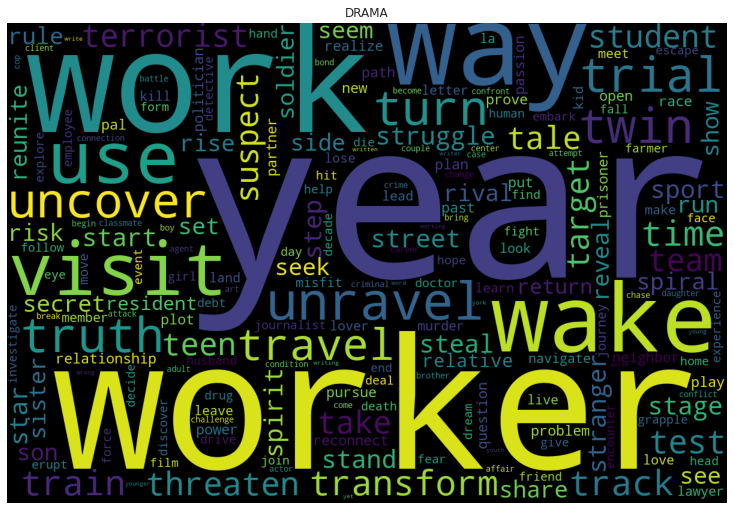

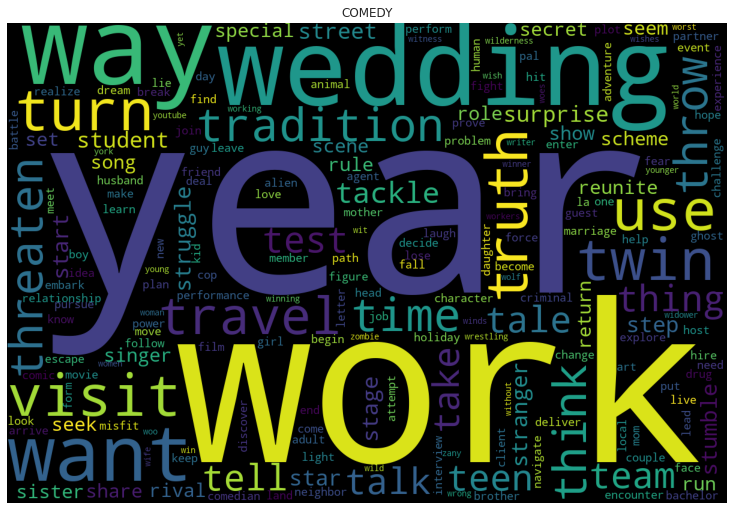

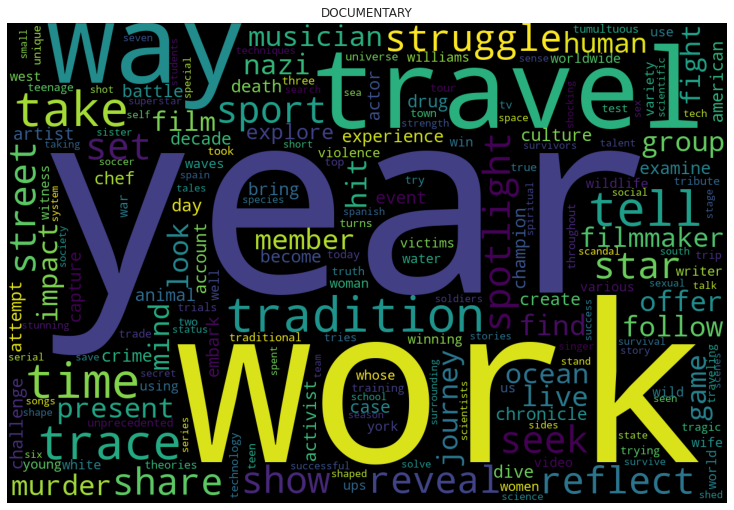

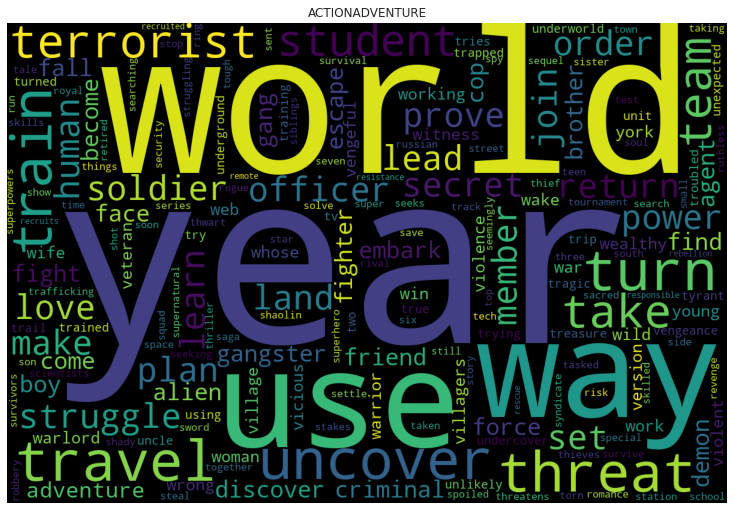

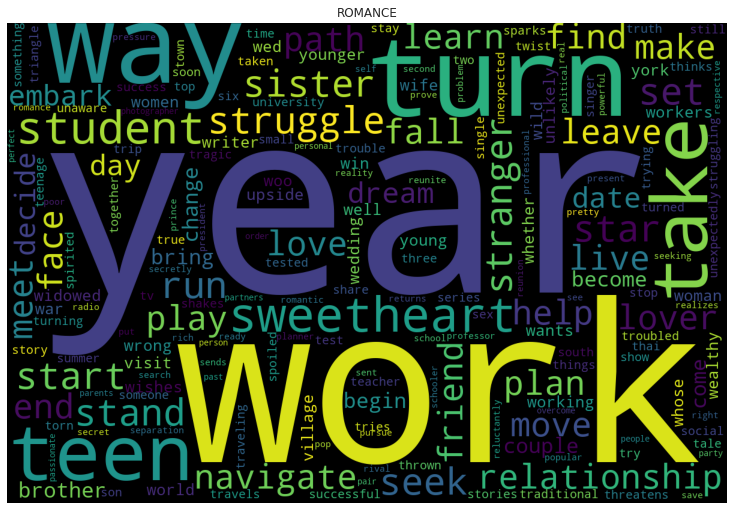

...

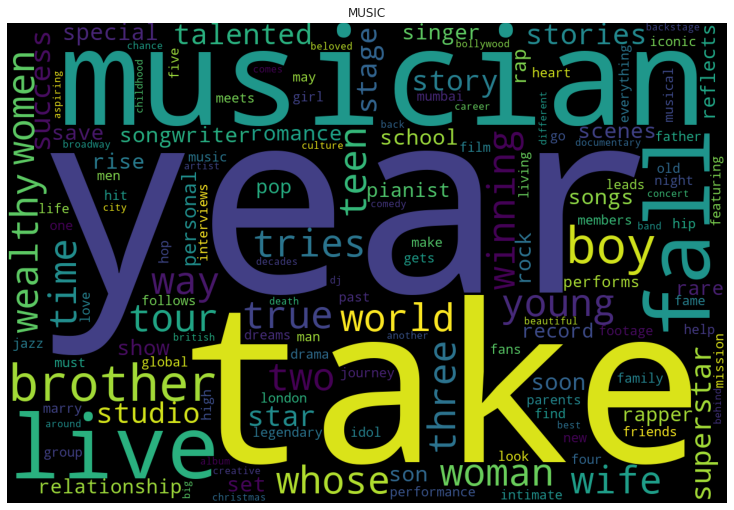

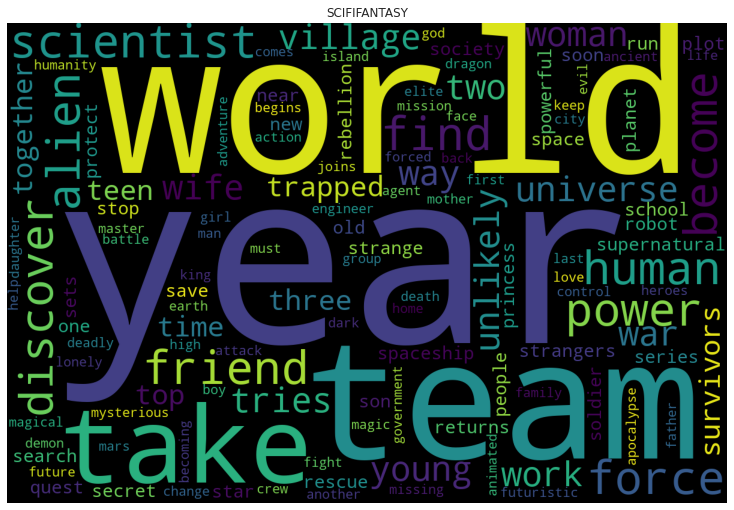

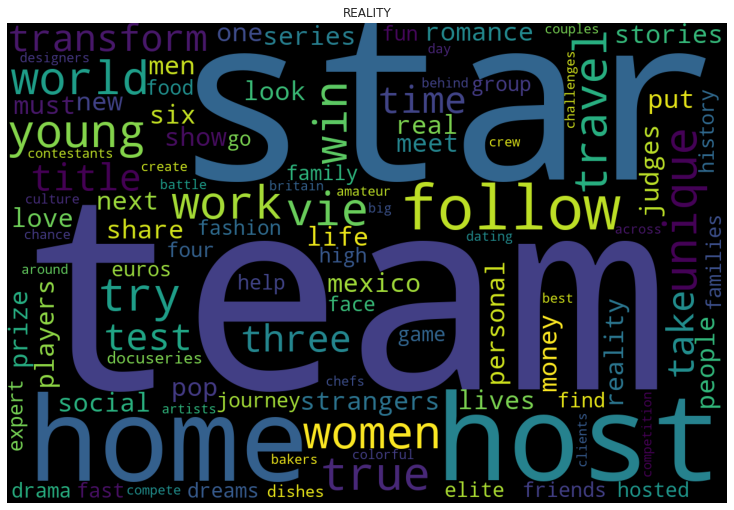

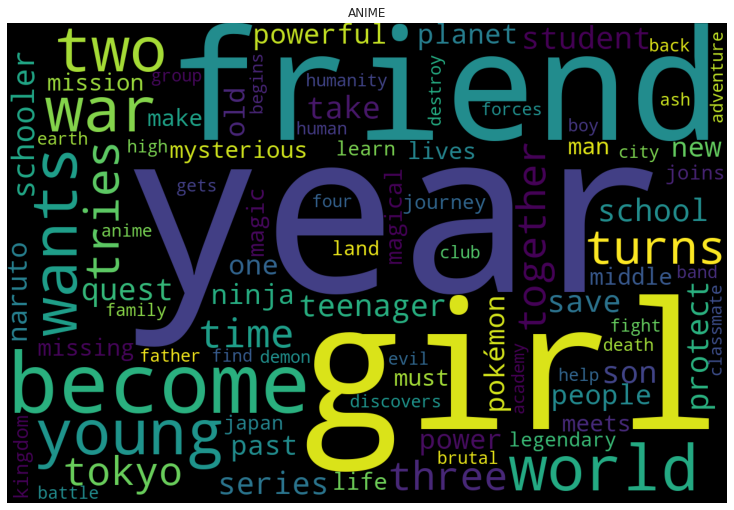

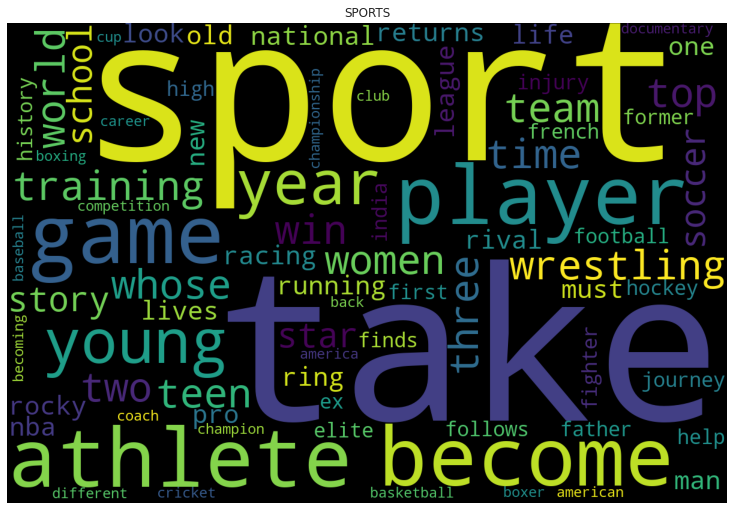

In [ ]:
plt.figure(figsize=(35, 30))
plt.suptitle("Word Cloud for Different Genres", fontsize=18, y=0.5)

for genre in top15genres:
  if genre != '':
    
    description_vectorizer_count = CountVectorizer(ngram_range = (1,1), min_df = 5, max_df = 0.7)
    # fit the count vectorizer using the text data
    description_vectorizer_count.fit(new_data[new_data.Genres == genre]['Processed Description'])
    dictionary = description_vectorizer_count.vocabulary_.items()

    vocab = []
    vocab_count = []
    # Iterate through each vocab and count append the value to designated lists
    for key, value in dictionary:
        vocab.append(key)
        vocab_count.append(value)

    count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(vocab_count)}).sort_values('Count', ascending= False)
    comment_words = ' '.join(count_description_df['Token'].to_list())
    
    wordcloud = WordCloud(width = 1200, height = 800,
                    background_color ='black',
                    min_font_size = 10, random_state = 33).generate(comment_words)
                    # plot the WordCloud image 
    plt.figure(figsize = (10, 7), facecolor = None)                     
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad = 0)
    plt.title(genre.upper())
    plt.show()

##### Bigram Bag of Words Wordcloud Generation of Content Description Based on Genre

In [ ]:
new_data = copy.copy()
new_data['Processed Description'] = new_data['Processed Description'] .apply(lambda x : joiner(x))

<Figure size 2520x2160 with 0 Axes>

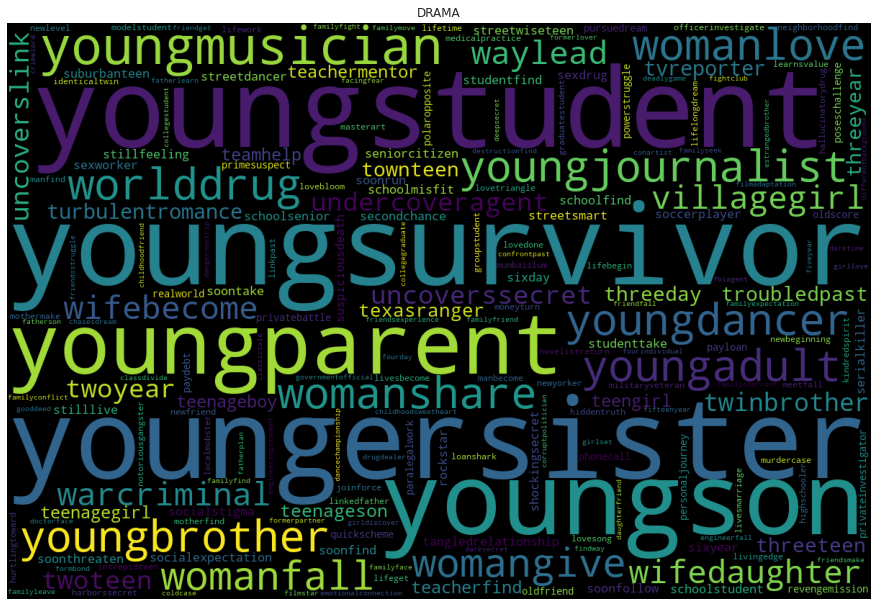

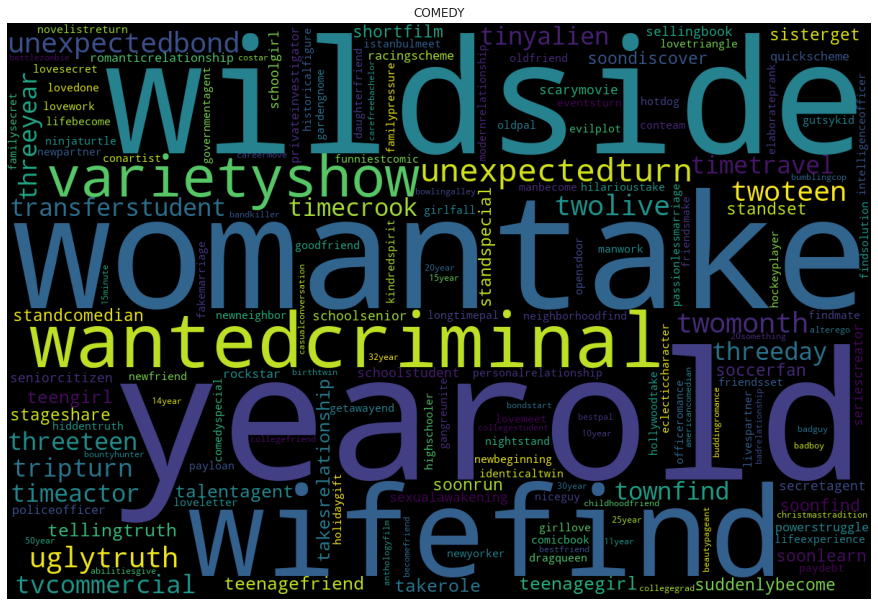

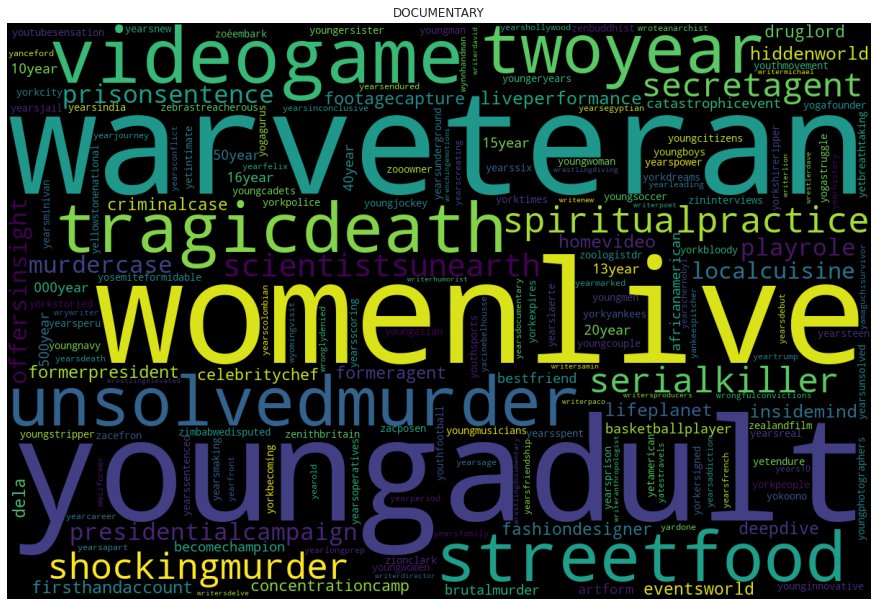

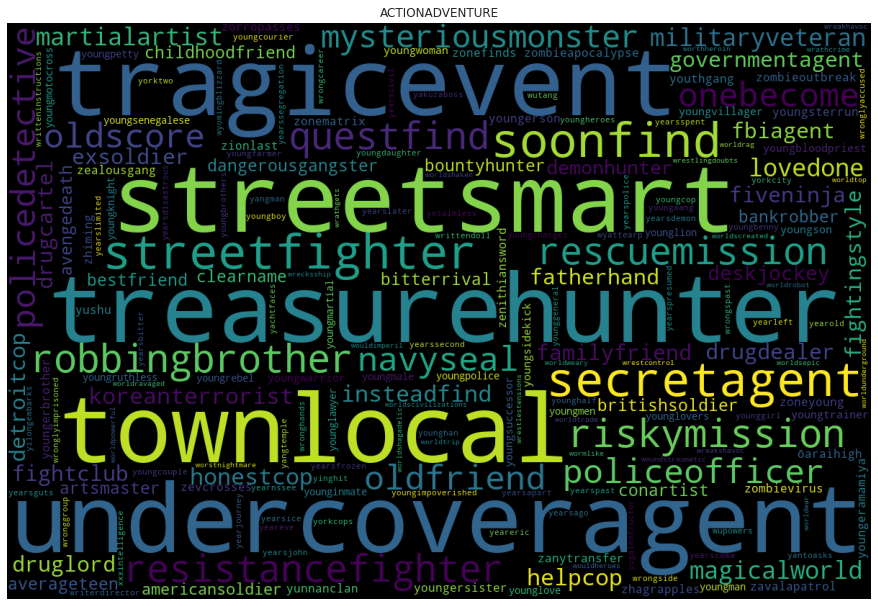

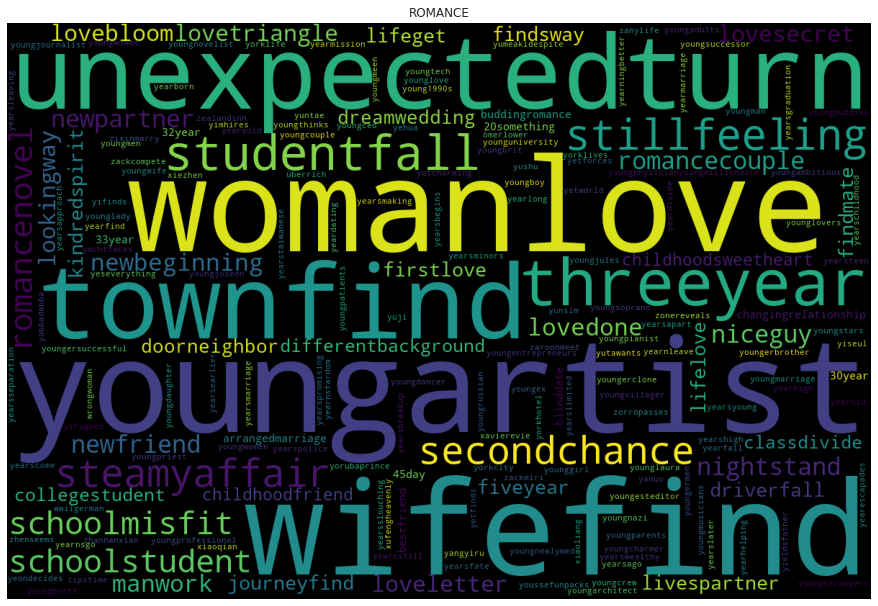

...

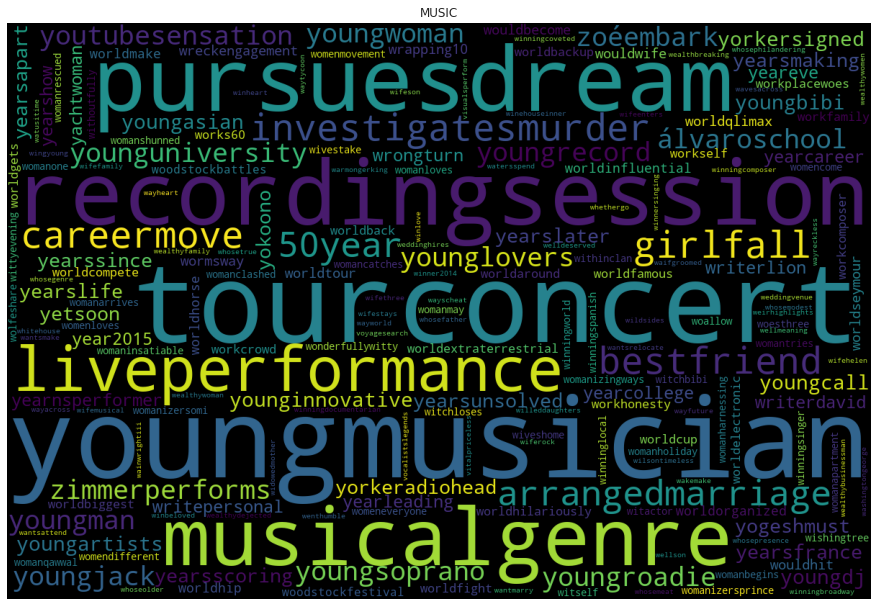

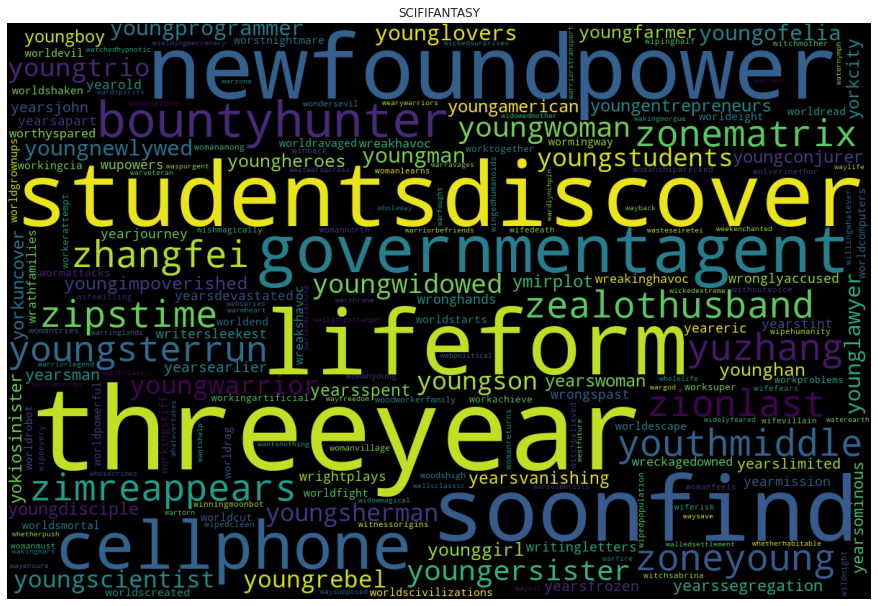

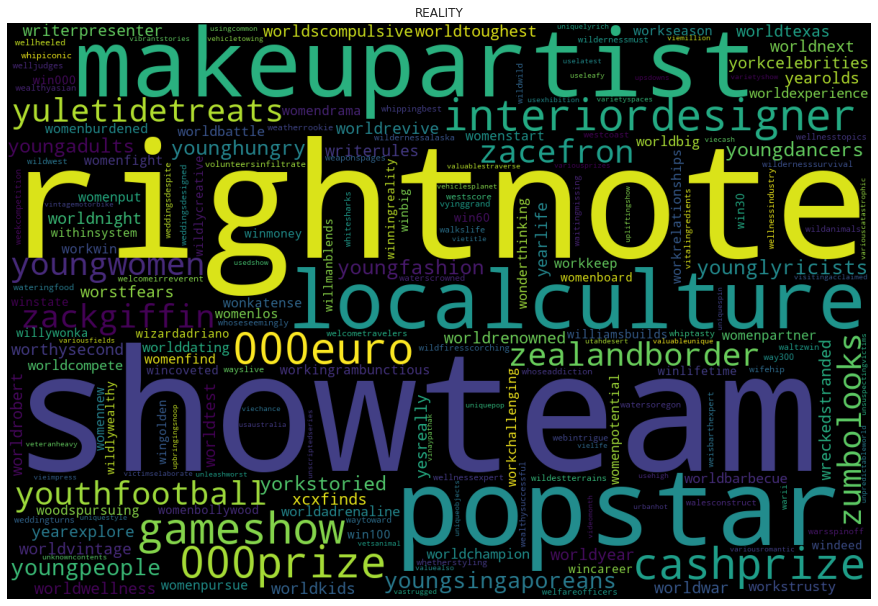

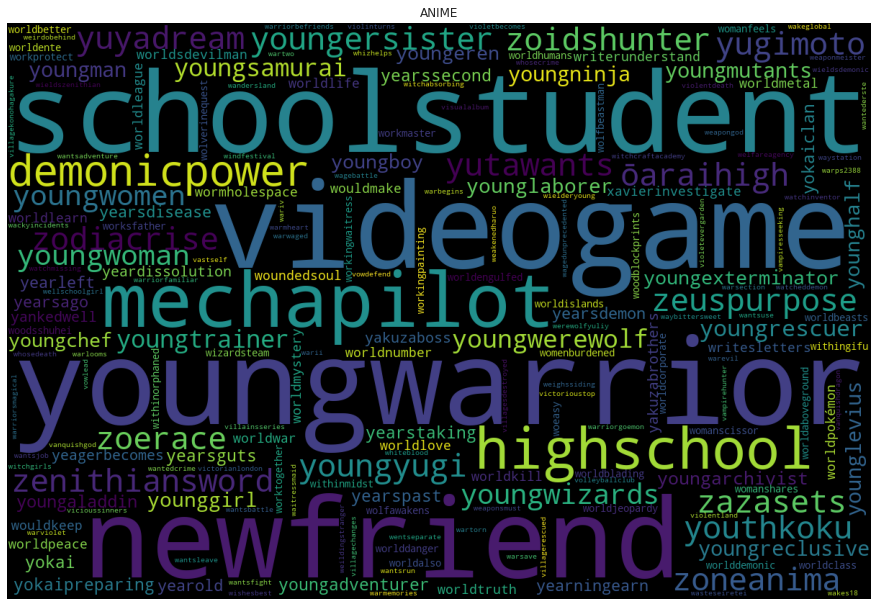

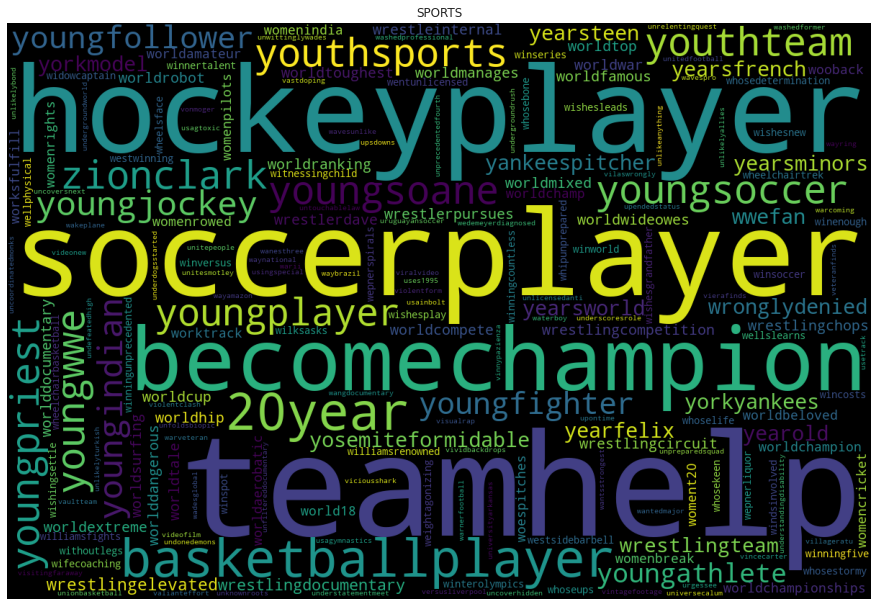

In [ ]:
plt.figure(figsize=(35, 30))
plt.suptitle("Word Cloud for Different Genres", fontsize=18, y=0.5)

for genre in top15genres:
  if genre != '':
    
    description_vectorizer_count = CountVectorizer(ngram_range = (2,2), min_df = 1, max_df = 0.7)
    # fit the count vectorizer using the text data
    description_vectorizer_count.fit(new_data[new_data.Genres == genre]['Processed Description'])
    dictionary = description_vectorizer_count.vocabulary_.items()

    vocab = []
    count_of_vocab = []
    # Iterate through each vocab and count append the value to designated lists
    for key, value in dictionary:
        vocab.append(key)
        count_of_vocab.append(value)

    count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(count_of_vocab)}).sort_values('Count', ascending = False)
    comment_words = ' '.join(count_description_df['Token'].apply(lambda row: ''.join(row.split(' '))).to_list())
        
    wordcloud = WordCloud(width = 1200, height = 800,
                    background_color ='black',
                    min_font_size = 10, random_state = 33).generate(comment_words)
                    # plot the WordCloud image 
    plt.figure(figsize = (12, 8), facecolor = None)                     
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad = 0)
    plt.title(genre.upper())
    plt.show()

#### Start Preparation of dataset for clustering

In [ ]:
clustering_data = netflix_data[['type', 'duration','rating','release_year']]

We Start Encoding TV and Movie ratings into one based on their age reccomendations.

In [ ]:
def topick(row):
  older_kids = ['TV-PG', 'PG', 'TV-Y7', 'TV-Y7-FV']
  kids_list = ['TV-G', 'G', 'TV-Y']
  teens_list = ['PG-13','TV-14']
  adult_list = ['R', 'NC-17', 'TV-MA', 'UR', 'NR']
  rating = 'Others'
  for column in older_kids + kids_list + teens_list + adult_list :
    if row[column] == 1:
      if column in older_kids:
        rating = 'Older Kids'
      elif column in kids_list :
        rating = 'Kids_list'
      elif column in teens_list :
        rating = 'Teens_list'
      elif column in adult_list :
        rating = 'Adult_list'      
  return rating

ratings = pd.get_dummies(clustering_data['rating']).drop('unidentified',axis=1).apply(lambda x: topick(x),axis=1)

##### Encoding Type, Rating

In [ ]:
clustering_data = pd.concat([clustering_data.drop(['type','rating'],axis =1),pd.get_dummies(ratings).drop('Others', axis=1), pd.get_dummies(clustering_data['type'])], axis =1)

In [ ]:
clustering_data

,duration,release_year,Adult_list,Kids_list,Older Kids,Teens_list,Movie,TV Show
0,4 Seasons,2020,1,0,0,0,0,1
1,93 min,2016,1,0,0,0,1,0
2,78 min,2011,1,0,0,0,1,0
3,80 min,2009,0,0,0,1,1,0
4,123 min,2008,0,0,0,1,1,0
...,...,...,...,...,...,...,...,...
7782,99 min,2005,1,0,0,0,1,0
7783,111 min,2015,0,0,0,1,1,0
7784,44 min,2019,1,0,0,0,1,0
7785,1 Season,2019,0,0,1,0,0,1


##### Processing Movie Duration

Extracting season numbers and movie duration as separate columns

In [ ]:
def duration(row,column):
  text = row['duration'].split()
  if column == 'show':
    if row['Movie'] == 0:
      return int(text[0])
    else:
      return 0
  if column == 'movie':
    if row['Movie'] ==1:
      return int(text[0])
    else:
      return 0
clustering_data['show_duration'] = clustering_data.apply(lambda x: duration(x,'show'),axis =1)
clustering_data['movie_duration'] = clustering_data.apply(lambda x: duration(x,'movie'), axis=1)

In [ ]:
clustering_data.drop('duration', axis = 1, inplace=True)

##### Binning Release Years based on decades

In [ ]:
(clustering_data['release_year']).unique()

array([2020, 2016, 2011, 2009, 2008, 2019, 1997, 2017, 2018, 2014, 2015,
       2010, 2005, 2013, 2012, 2006, 2000, 2003, 1989, 2004, 1977, 1971,
       1993, 2007, 1998, 1988, 1996, 2002, 1986, 1990, 1979, 1980, 1974,
       2001, 1999, 1966, 1991, 1982, 1994, 1995, 1978, 1992, 1972, 1975,
       2021, 1973, 1967, 1960, 1981, 1958, 1976, 1968, 1956, 1985, 1965,
       1984, 1983, 1987, 1945, 1946, 1962, 1925, 1942, 1969, 1955, 1963,
       1964, 1954, 1970, 1944, 1947, 1959, 1943])

In [ ]:
def release_year_bin(row):
  r_year = row['release_year']
  for yr in np.arange(2030,1910,-10):
    if r_year >= yr:
      return (yr)

clustering_data['release_year_bins'] =(clustering_data.apply(lambda x: release_year_bin(x), axis=1))

In [ ]:
clustering_data

,release_year,Adult_list,Kids_list,Older Kids,Teens_list,Movie,TV Show,show_duration,movie_duration,release_year_bins
0,2020,1,0,0,0,0,1,4,0,2020
1,2016,1,0,0,0,1,0,0,93,2010
2,2011,1,0,0,0,1,0,0,78,2010
3,2009,0,0,0,1,1,0,0,80,2000
4,2008,0,0,0,1,1,0,0,123,2000
...,...,...,...,...,...,...,...,...,...,...
7782,2005,1,0,0,0,1,0,0,99,2000
7783,2015,0,0,0,1,1,0,0,111,2010
7784,2019,1,0,0,0,1,0,0,44,2010
7785,2019,0,0,1,0,0,1,1,0,2010


In [ ]:
# Importing other required libraries
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import linear_kernel
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer


import matplotlib.cm as cm
from sklearn import metrics
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


from sklearn.cluster import KMeans , AgglomerativeClustering, DBSCAN
from sklearn.cluster import AffinityPropagation
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score, davies_bouldin_score, calinski_harabasz_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder

##### Topic Modeling Using GENSIM

Gensim is a open-source Python library used in NLP and Topic Modeling.

In [ ]:
input_topic = netflix_data['Processed Description'] + ' ' + netflix_data['Processed Movie Deets']

In [ ]:
# Importing other required libraries
from gensim.models.ldamulticore import LdaMulticore
from gensim.models.coherencemodel import CoherenceModel
from gensim.corpora import Dictionary

In [ ]:
gensim_paragraphs = (input_topic).apply(lambda row: row.split(' '))
dict_gensim_para = Dictionary(gensim_paragraphs) # dictionary of corpus
dict_gensim_para.filter_extremes(no_below=5, no_above=0.6)
bow_gensim_para = [dict_gensim_para.doc2bow(paragraph) for paragraph in gensim_paragraphs] #creating corpus

Performing TFIDF Vector

In [ ]:
from gensim.models import TfidfModel
tfidf_gensim_para = TfidfModel(bow_gensim_para)
vectors_gensim_para = tfidf_gensim_para[bow_gensim_para]

In [ ]:
lda_para_model_n = []
for n in (range(5, 16)):
  lda_model = LdaMulticore(corpus=bow_gensim_para, id2word=dict_gensim_para,
                            chunksize=1000, eta='auto', iterations=400,
                            num_topics=n, passes=20, eval_every=None,
                            random_state=42)
  lda_coherence = CoherenceModel(model=lda_model, texts=gensim_paragraphs,
                            dictionary=dict_gensim_para, coherence='c_npmi') 
  print(n,'|', lda_coherence.get_coherence())
  lda_para_model_n.append((n, lda_model, lda_coherence.get_coherence()))

5 | -0.005675361387931289
6 | 0.006360050537592439
7 | 0.007446805681558341
8 | 0.017321913662269452
9 | 0.021698859741481284
10 | 0.015635626001441583
11 | 0.0035584430500326353
12 | 0.016407386271861512
13 | -0.0030747813013482133
14 | -0.0013061656216593282
15 | -0.0016582079644728686


([<matplotlib.axis.XTick at 0x7fae5ad08ed0>,
 <a list of 21 Text major ticklabel objects>)

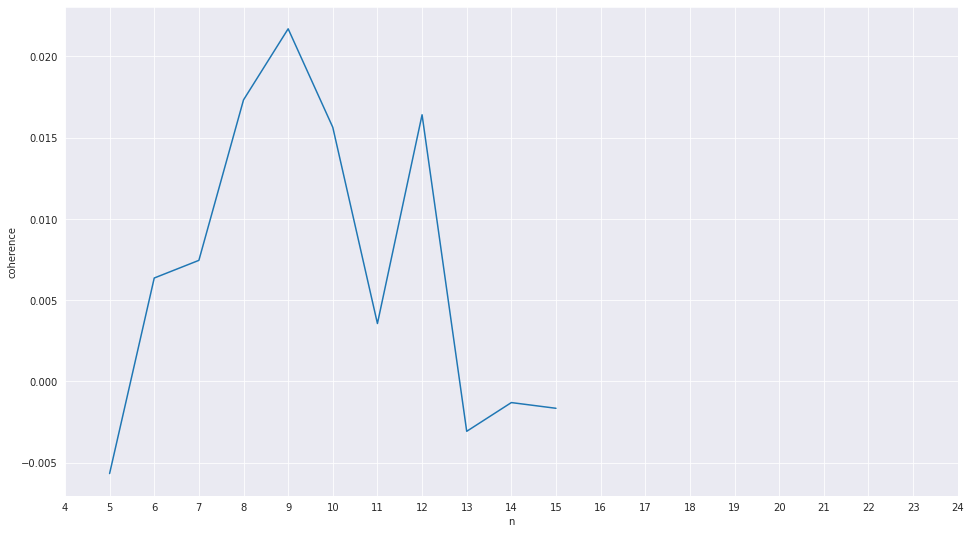

In [ ]:
lda_df = pd.DataFrame(lda_para_model_n, columns=["n", "model", "coherence"]).set_index("n")[["coherence"]]
plt.figure(figsize=(16,9))
sns.lineplot(x='n', y='coherence', data=lda_df )
plt.xticks(ticks = np.arange(4,25,1))

In [ ]:
lda_df = lda_df.reset_index()
topic_nums = lda_df[lda_df['coherence']==lda_df['coherence'].max()]['n'].to_list()[0]
topic_nums

9

In [ ]:
lda_gensim_para = LdaMulticore(corpus=bow_gensim_para, id2word=dict_gensim_para,
                            chunksize=2000, eta='auto', iterations=400,
                            num_topics= topic_nums , passes=20, eval_every=None,
                            random_state=42)

In [ ]:
#We Create a function to display gensim topics
def display_gensim_topics(model):
  gen_list = lda_gensim_para.print_topics()
  for i in range(0,len(gen_list)):
    print('Topic: ',i+1,'\n')
    topics = gen_list[i][1]
    for j in topics.split('+'):
      print(j.split('"')[1])

    print("------\n")

display_gensim_topics(lda_gensim_para)

Topic:  1 

drama
comedy
romance
find
young
famili
life
woman
live
man
------

Topic:  2 

drama
horror
thriller
young
famili
begin
life
mysteri
home
woman
------

Topic:  3 

actionadventure
scififantasy
drama
anime
world
power
kids
fight
save
war
------

Topic:  4 

comedy
school
drama
high
family
teen
student
new
get
world
------

Topic:  5 

crime
drama
actionadventure
thriller
murder
cop
investig
polic
drug
detect
------

Topic:  6 

documentary
documentari
music
seri
world
stori
explor
film
life
histori
------

Topic:  7 

comedy
drama
romance
life
find
year
love
new
friend
get
------

Topic:  8 

drama
comedy
love
romance
famili
young
man
woman
fall
two
------

Topic:  9 

comedy
kids
family
friend
stand
comedi
special
comedian
take
show
------



In [ ]:
pip install pyLDAvis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.7 MB 32.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
  Created wheel for pyLDAvis: filename=pyLDAvis-3.3.1-py2.py3-none-any.whl size=136898 sha256=e11224b13c7d268fcd7e7f6b8ac905cc0afc289eab4e92e6c91c0987df03afef
  Stored in directory: /root/.cache/pip/wheels/c9/21/f6/17bcf2667e8a68532ba2fbf6d5c72fdf4c7f7d9abfa4852d2f
  Created wheel for sklearn: filename=sklearn-0.0-py2.py3-none-any.whl size=1310 sha256=d5ab70fbc3d288538e44d084ab4fdf1819686efe2d9e3c9784a87a4a402fe788
  Stored in directory: /root/.cache/pip/wheels/46/ef/c3/157e41f5ee1372d1be90b09f74f82b10e391eaacca8f22d33e
Successfully built pyLDAvis sklearn


In [ ]:
import pyLDAvis   # pyLDAvis is an open-source python library that helps in analyzing and creating highly interactive visualization of the clusters created by LDA.
import pyLDAvis.gensim_models

/usr/local/lib/python3.7/dist-packages/past/types/oldstr.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Iterable


In [ ]:
pyLDAvis.enable_notebook()
show = pyLDAvis.gensim_models.prepare(lda_gensim_para, bow_gensim_para, dict_gensim_para)
show

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
8      0.168955 -0.068861       1        1  12.922290
7     -0.086466 -0.047052       2        1  12.724978
5      0.208495  0.050651       3        1  12.699285
6     -0.046254 -0.118321       4        1  12.211248
4     -0.101319  0.150709       5        1  11.182266
2      0.020747  0.171434       6        1  10.777319
1     -0.098012 -0.010948       7        1   9.567417
3      0.020025 -0.083089       8        1   9.436465
0     -0.086169 -0.044523       9        1   8.478732, topic_info=                Term         Freq        Total Category  logprob  loglift
171      documentary  1048.000000  1048.000000  Default  30.0000  30.0000
158            crime   573.000000   573.000000  Default  29.0000  29.0000
241           comedy  2283.000000  2283.000000  Default  28.0000  28.0000
48   actionadventure   812.000000   812.000000  Default  27.0000  27.0000
3              drama  2882.000000  2882.000000  Default  26.0000  26.0000
..               ...          ...          ...      ...      ...      ...
223           friend    38.333315   535.255573   Topic9  -5.5843  -0.1688
99              must    34.470242   333.564458   Topic9  -5.6905   0.1979
113              new    36.389989   623.876360   Topic9  -5.6363  -0.3740
63             becom    32.592643   365.656083   Topic9  -5.7465   0.0500
787            music    31.669352   447.489741   Topic9  -5.7753  -0.1807

[685 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
828       1  0.784958       000
828       4  0.058145       000
828       6  0.145363       000
557       1  0.951071       100
736       6  0.955600        18
...     ...       ...       ...
238       7  0.194592     young
238       8  0.066845     young
238       9  0.124777     young
3948      2  0.990259        yu
2817      6  0.925402  yukikaji

[1849 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[9, 8, 6, 7, 5, 3, 2, 4, 1])

In [ ]:
lda = {}
for i in range(0,lda_gensim_para.num_topics):
  lda[f'Topic {i}'] = np.zeros(netflix_data.shape[0])

In [ ]:
for i, row in enumerate(lda_gensim_para[bow_gensim_para]):
  for topic in row:
    lda[f'Topic {topic[0]}'][i] = topic[1] 


topic_model_data = pd.DataFrame(lda)
topic_model_data

,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8
0,0.220864,0.000000,0.567290,0.000000,0.0,0.000000,0.081104,0.098043,0.000000
1,0.000000,0.000000,0.265258,0.000000,0.0,0.000000,0.481466,0.000000,0.216224
2,0.000000,0.474659,0.387171,0.101125,0.0,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.236206,0.451470,0.000000,0.0,0.000000,0.000000,0.000000,0.275276
4,0.000000,0.471355,0.000000,0.173242,0.0,0.000000,0.000000,0.000000,0.318350
...,...,...,...,...,...,...,...,...,...
7782,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.925891,0.000000
7783,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.090410,0.783268,0.091215
7784,0.000000,0.000000,0.077272,0.000000,0.0,0.876957,0.000000,0.000000,0.000000
7785,0.340956,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.603469


In [ ]:
def topic_input(row):
  highest = 0
  top = 'None'
  for topic in topic_model_data.columns:
    if row[topic] > highest:
      highest = row[topic]
      top = f'Topic {int(topic[-1])+1}'
  return top

topic = topic_model_data.apply(lambda x:topic_input(x),axis=1)


CREATING WORD CLOUDS FOR TOPICS

In [ ]:
new_data = copy.copy()
new_data['Processed Description'] = new_data['Processed Description'] .apply(lambda x : joiner(x))
new_data = pd.concat([new_data,pd.DataFrame(topic, columns = ['Topic'])],axis=1) 

<Figure size 2520x2160 with 0 Axes>

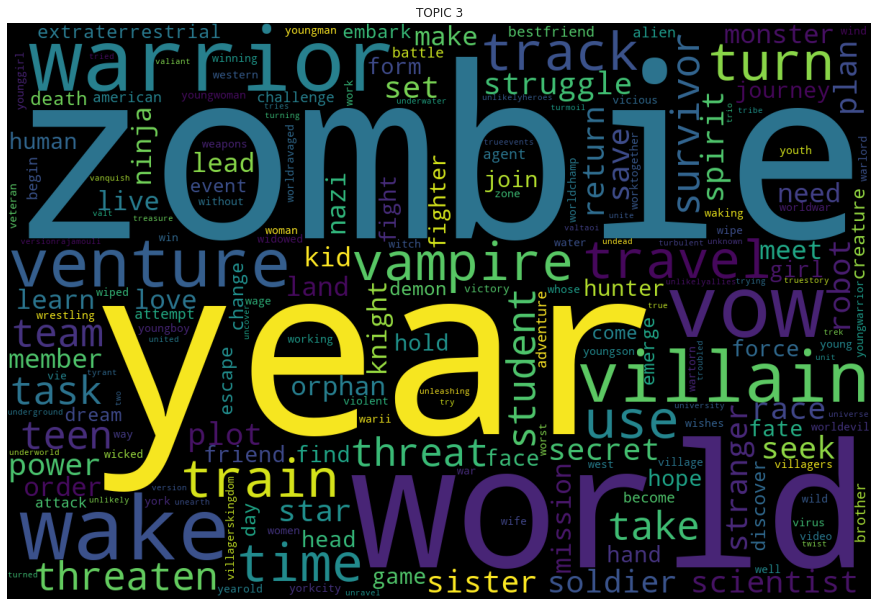

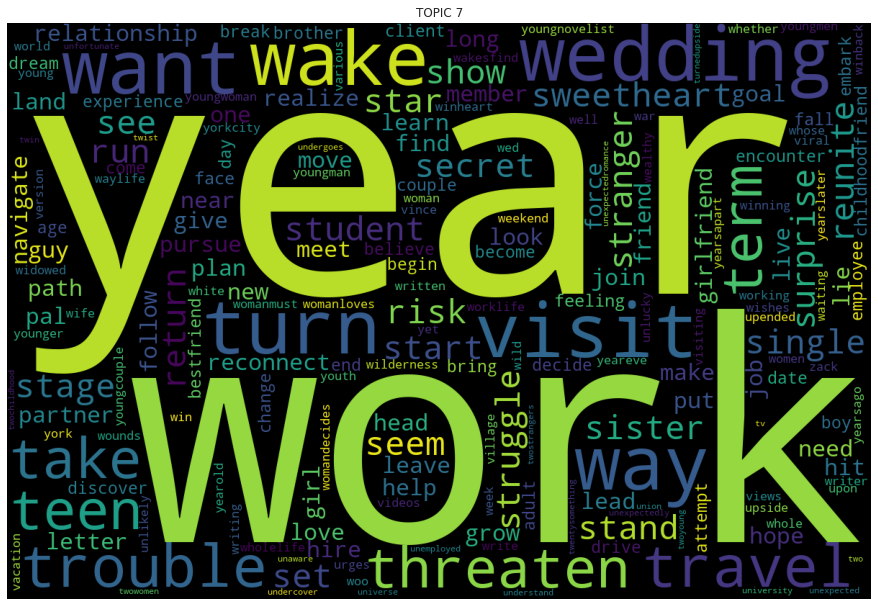

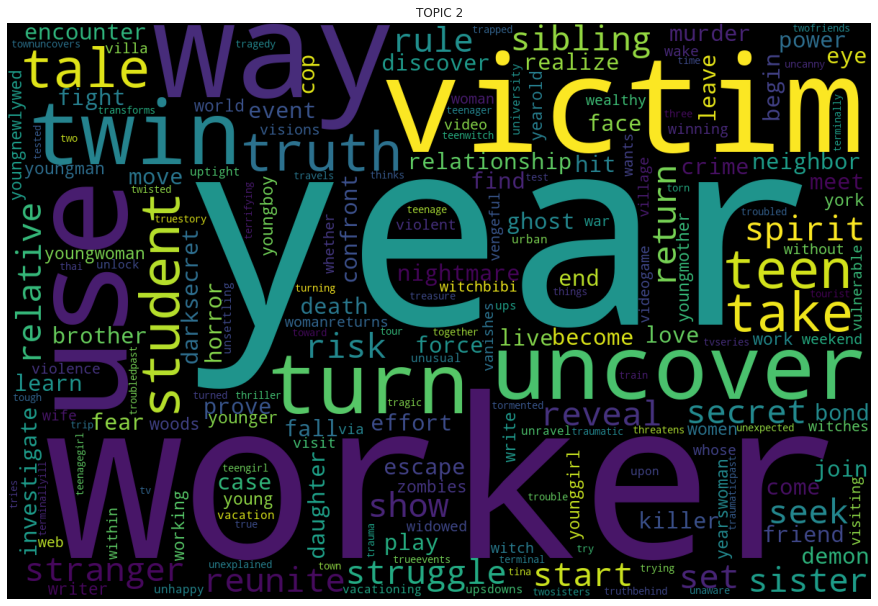

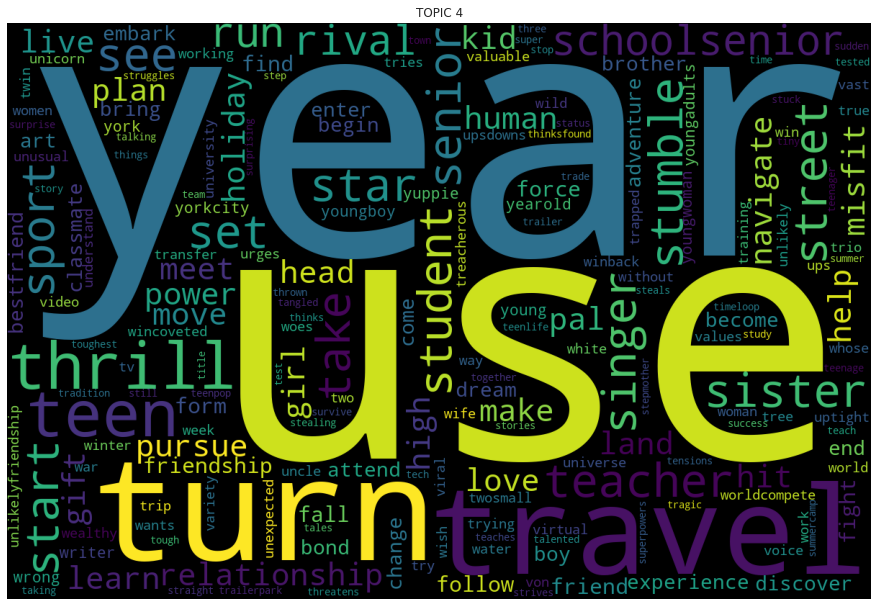

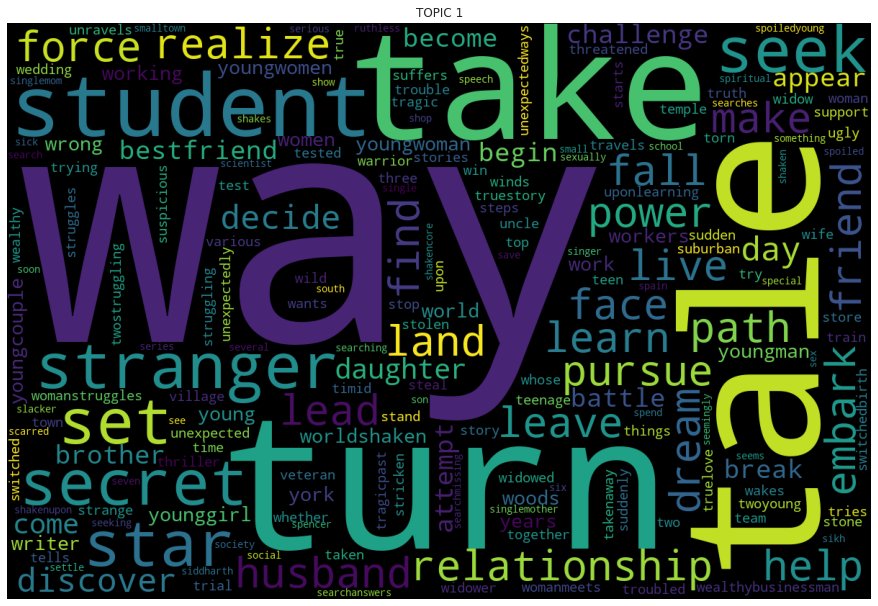

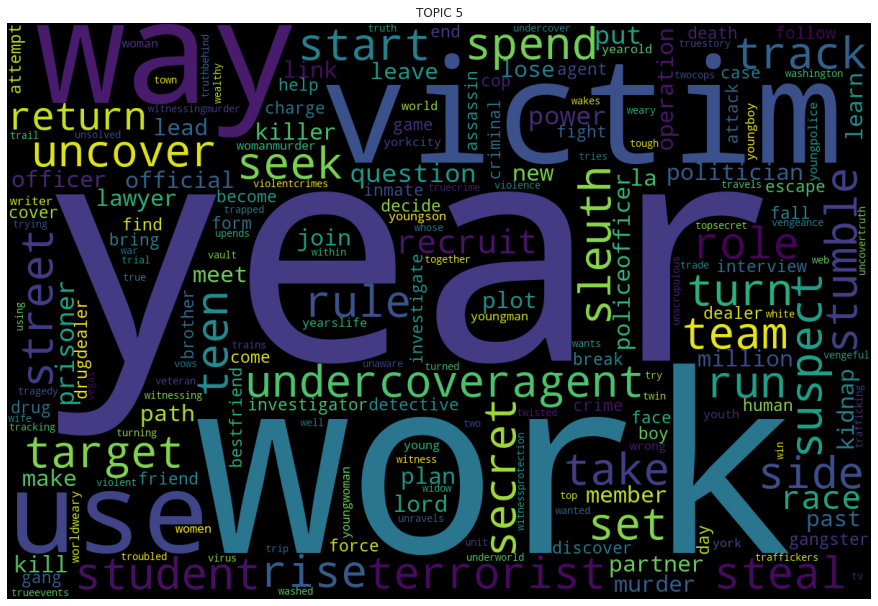

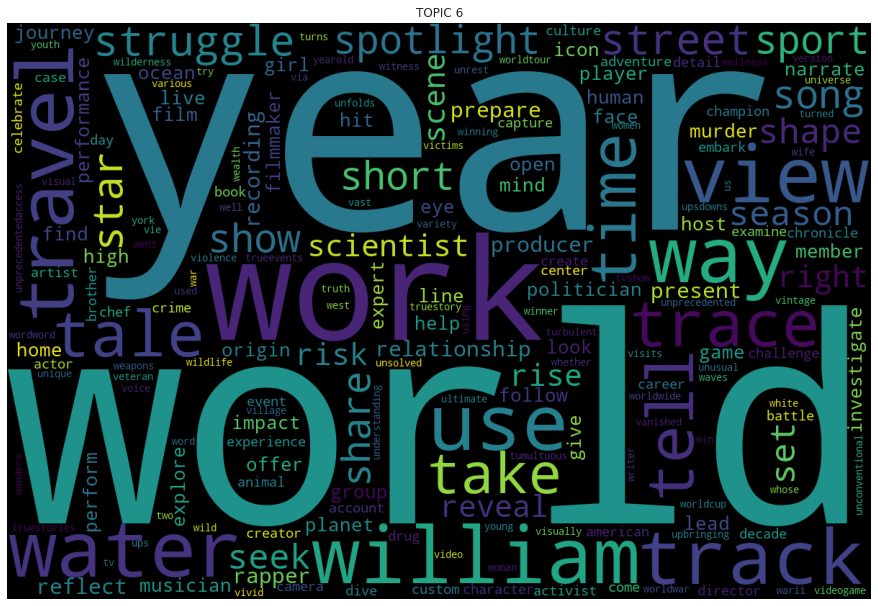

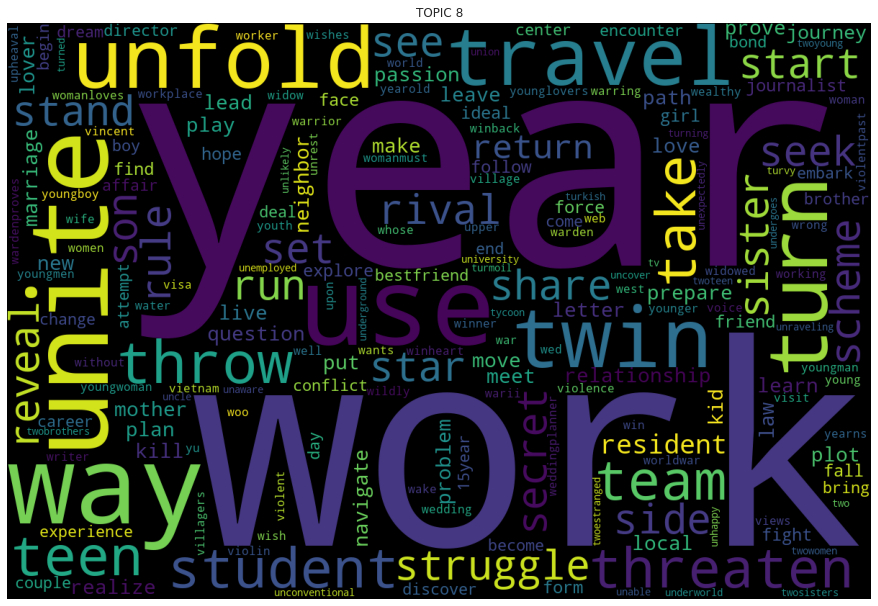

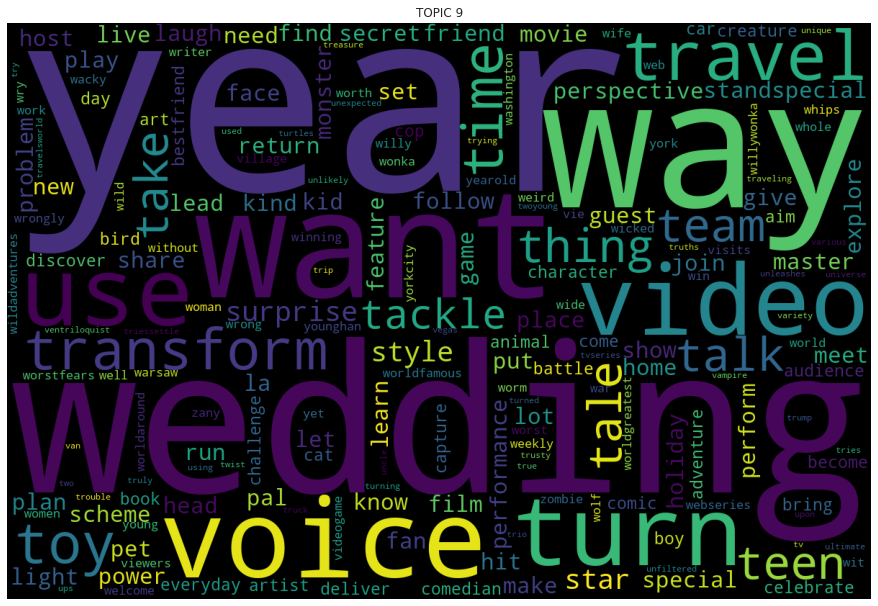

In [ ]:
plt.figure(figsize=(35, 30))
plt.suptitle("Word Cloud for Different Genres", fontsize=18, y=0.5)

for top in topic.unique():

  description_vectorizer_count = CountVectorizer(ngram_range = (1,2), min_df = 5, max_df = 0.7)
  # fit the count vectorizer using the text data
  description_vectorizer_count.fit(new_data[new_data['Topic'] == top]['Processed Description'])
  dictionary = description_vectorizer_count.vocabulary_.items()

  vocab = []
  vocab_count = []
  # Iterate through each vocab and count append the value to designated lists
  for key, value in dictionary:
      vocab.append(key)
      vocab_count.append(value)


  description_data_count = pd.DataFrame({'Token':vocab, 'Count':np.array(vocab_count)}).sort_values('Count', ascending = False)
  comment_words = ' '.join(description_data_count['Token'].apply(lambda row: ''.join(row.split(' '))).to_list())
      
  wordcloud = WordCloud(width = 1200, height = 800,
                  background_color ='black',
                  min_font_size = 10).generate(comment_words)
                  # plot the WordCloud image 
  plt.figure(figsize = (12, 8), facecolor = None)                     
  plt.imshow(wordcloud)
  plt.axis("off")
  plt.tight_layout(pad = 0)
  plt.title(top.upper())
  plt.show()

##### Concatenating clustering_df with topic models

In [ ]:
clustering_data

,release_year,Adult_list,Kids_list,Older Kids,Teens_list,Movie,TV Show,show_duration,movie_duration,release_year_bins
0,2020,1,0,0,0,0,1,4,0,2020
1,2016,1,0,0,0,1,0,0,93,2010
2,2011,1,0,0,0,1,0,0,78,2010
3,2009,0,0,0,1,1,0,0,80,2000
4,2008,0,0,0,1,1,0,0,123,2000
...,...,...,...,...,...,...,...,...,...,...
7782,2005,1,0,0,0,1,0,0,99,2000
7783,2015,0,0,0,1,1,0,0,111,2010
7784,2019,1,0,0,0,1,0,0,44,2010
7785,2019,0,0,1,0,0,1,1,0,2010


##### Scaling

In [ ]:
vectorizer_clustering = pd.concat([clustering_data.drop(['release_year'], axis=1),], axis =1)
vectorizer_clustering

,Adult_list,Kids_list,Older Kids,Teens_list,Movie,TV Show,show_duration,movie_duration,release_year_bins
0,1,0,0,0,0,1,4,0,2020
1,1,0,0,0,1,0,0,93,2010
2,1,0,0,0,1,0,0,78,2010
3,0,0,0,1,1,0,0,80,2000
4,0,0,0,1,1,0,0,123,2000
...,...,...,...,...,...,...,...,...,...
7782,1,0,0,0,1,0,0,99,2000
7783,0,0,0,1,1,0,0,111,2010
7784,1,0,0,0,1,0,0,44,2010
7785,0,0,1,0,0,1,1,0,2010


In [ ]:
scaler = MinMaxScaler()
X_rescale = scaler.fit_transform(vectorizer_clustering)
#dataset contains degree of belonging of document to each topic concatenated to scaled Dataframe 
X = pd.concat([pd.DataFrame(X_rescale,columns = vectorizer_clustering.columns ),(topic_model_data)],axis=1)
X

,Adult_list,Kids_list,Older Kids,Teens_list,Movie,TV Show,show_duration,movie_duration,release_year_bins,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8
0,1.0,0.0,0.0,0.0,0.0,1.0,0.2500,0.000000,1.0,0.220864,0.000000,0.567290,0.000000,0.0,0.000000,0.081104,0.098043,0.000000
1,1.0,0.0,0.0,0.0,1.0,0.0,0.0000,0.298077,0.9,0.000000,0.000000,0.265258,0.000000,0.0,0.000000,0.481466,0.000000,0.216224
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0000,0.250000,0.9,0.000000,0.474659,0.387171,0.101125,0.0,0.000000,0.000000,0.000000,0.000000
3,0.0,0.0,0.0,1.0,1.0,0.0,0.0000,0.256410,0.8,0.000000,0.236206,0.451470,0.000000,0.0,0.000000,0.000000,0.000000,0.275276
4,0.0,0.0,0.0,1.0,1.0,0.0,0.0000,0.394231,0.8,0.000000,0.471355,0.000000,0.173242,0.0,0.000000,0.000000,0.000000,0.318350
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7782,1.0,0.0,0.0,0.0,1.0,0.0,0.0000,0.317308,0.8,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.925891,0.000000
7783,0.0,0.0,0.0,1.0,1.0,0.0,0.0000,0.355769,0.9,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.090410,0.783268,0.091215
7784,1.0,0.0,0.0,0.0,1.0,0.0,0.0000,0.141026,0.9,0.000000,0.000000,0.077272,0.000000,0.0,0.876957,0.000000,0.000000,0.000000
7785,0.0,0.0,1.0,0.0,0.0,1.0,0.0625,0.000000,0.9,0.340956,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.603469


In [ ]:
X = X.to_numpy()
X.shape

(7787, 18)

##### Performing Hopkins test for uniform distribution to check if clustering is possible on the dataset

In [ ]:
pip install pyclustertend

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from pyclustertend import hopkins
hopkins(X,150)

0.06705196840356951

In [ ]:
X.shape

(7787, 18)

Creating Dictionary For Report

In [ ]:
clustering_report = {
    'Algorithm':[],
    'Parameters':[],
    'Clusters':[],
    'Silhouette Coefficient':[],
    'Davies-Bouldin Index': [],
    'Calinski-Harbaz Score': []
}

In [ ]:
def update_report(algo_name, details,clusters, sil_score, db_index, ch_score):
  data = [algo_name, details, clusters,sil_score, db_index, ch_score]
  for i,detail in enumerate(clustering_report):
    clustering_report[detail].append(data[i])

#### DBSCAN Clustering Algorithm

DBSCAN stands for Density-Based Spatial Clustering of Applications with Noise. Density-Based Clustering refers to unsupervised learning methods that identify distinctive groups/clusters in the data, based on the idea that a cluster in data space is a contiguous region of high point density, separated from other such clusters by contiguous regions of low point density.
The DBSCAN algorithm uses two parameters:
* minPts: The minimum number of points (a threshold) clustered together for a region to be considered dense.
* eps (ε): A distance measure that will be used to locate the points in the neighborhood of any point. 

##### FITTING AND PREDICTING DATA WITH DBSCAN with default values

In [ ]:
dbscan = DBSCAN().fit(X)
preds = dbscan.labels_

In [ ]:
# calculating silhouette scores
silhouette_score(X,preds)

0.4683023707490539

In [ ]:
davies_bouldin_score(X,preds)

1.6176493058194303

In [ ]:
calinski_harabasz_score(X,preds)

2538.1372639076176

In [ ]:
# Check the number of cluster
pd.Series(preds).nunique()

9

In [ ]:
update_report('DBSCAN','Default' ,pd.Series(preds).nunique(), silhouette_score(X,preds), davies_bouldin_score(X,preds), calinski_harabasz_score(X,preds))

Key Insights
* DBSCAN clustered the data into 10 clusters with a silhouette score 0.43875

In [ ]:
# Start Visualisation. we're taking three significant components using PCA and plotting them 2 the front,side and top view of the 3d space. This way we can see how the clusters are arranged spatially
predictions = pd.DataFrame(preds, columns = ['Labels'])

In [ ]:
# Start Dimensionality reduction using PCA (Principal Component Analysis)
pca = PCA(n_components = 3)

In [ ]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
dbscan_cluster = pd.concat([reduced, predictions], axis=1)

In [ ]:
#setting colors for all visualisations
colors_list = " #000000 dimgray #696969 silver #c0c0c0 darkslategray #2f4f4f darkolivegreen #556b2f olivedrab #6b8e23 sienna #a0522d seagreen #2e8b57 forestgreen #228b22 maroon2 #7f0000 midnightblue #191970 darkgreen #006400 olive #808000 darkslateblue #483d8b firebrick #b22222 lightslategray #778899 mediumseagreen #3cb371 rosybrown #bc8f8f rebeccapurple #663399 darkgoldenrod #b8860b darkkhaki #bdb76b darkcyan #008b8b steelblue #4682b4 chocolate #d2691e yellowgreen #9acd32 darkblue #00008b indigo #4b0082 limegreen #32cd32 darkseagreen #8fbc8f darkmagenta #8b008b maroon3 #b03060 mediumturquoise #48d1cc mediumaquamarine #66cdaa darkorchid #9932cc orangered #ff4500 orange #ffa500 gold #ffd700 yellow #ffff00 mediumvioletred #c71585 mediumblue #0000cd burlywood #deb887 chartreuse #7fff00 lime #00ff00 mediumorchid #ba55d3 springgreen #00ff7f darksalmon #e9967a crimson #dc143c aqua #00ffff deepskyblue #00bfff sandybrown #f4a460 mediumpurple #9370db blue #0000ff purple3 #a020f0 lightcoral #f08080 greenyellow #adff2f tomato #ff6347 thistle #d8bfd8 fuchsia #ff00ff palevioletred #db7093 khaki #f0e68c laserlemon #ffff54 cornflower #6495ed plum #dda0dd lightgreen #90ee90 lightblue #add8e6 deeppink #ff1493 mediumslateblue #7b68ee violet #ee82ee lightskyblue #87cefa aquamarine #7fffd4 lightgoldenrod #fafad2 hotpink #ff69b4 mistyrose #ffe4e1 lightcyan #e0ffff pink #ffc0cb"
colors = [color for color in colors_list.split(' ') if '#' in color]

#looping to shuffle colors
np.random.seed(151203)
shuffled = []
while len(colors)!=0:
  a = np.random.choice(colors)
  shuffled.append(a)
  colors.remove(a)

gyr = shuffled[:pd.Series(preds).nunique()]

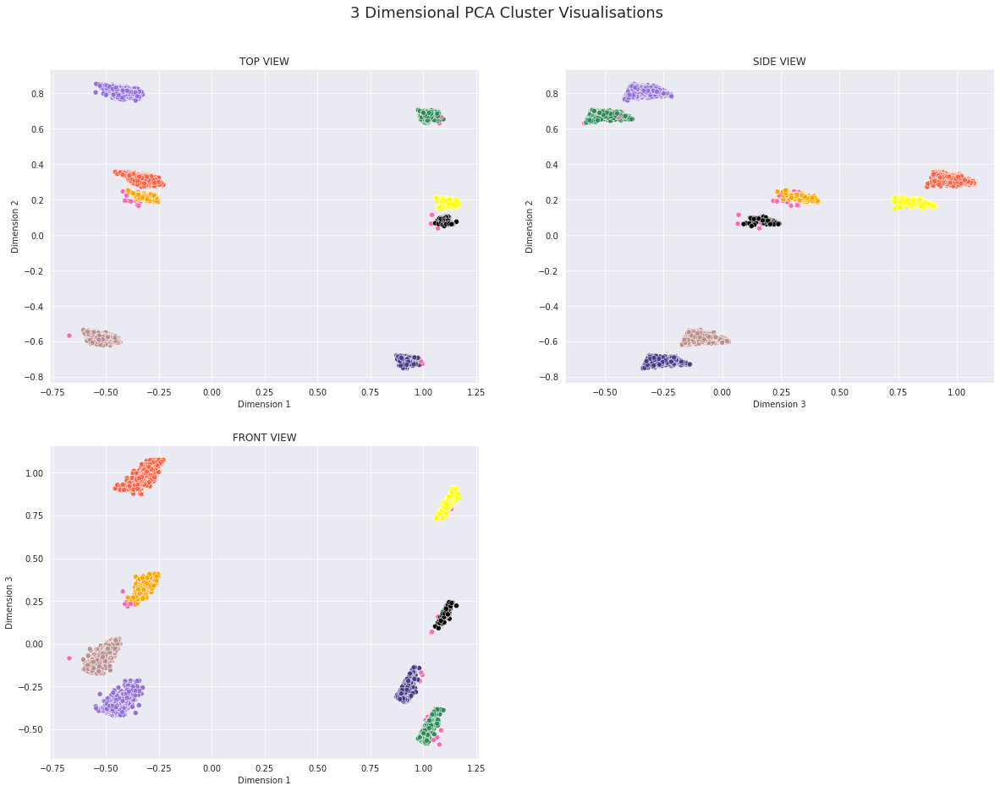

In [ ]:
plt.figure(figsize=(20,15))
plt.suptitle("3 Dimensional PCA Cluster Visualisations", fontsize=18, y=0.95)

plt.subplot(2,2,1)
plt.title('TOP VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = dbscan_cluster,palette = sns.color_palette(gyr), hue = 'Labels', legend=False)

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2',  data = dbscan_cluster,palette = sns.color_palette(gyr), hue = 'Labels', legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = dbscan_cluster,palette = sns.color_palette(gyr), hue = 'Labels',legend=False)

#### Start K-means Clustering Algorithm


As we know K-means clustering is a type of unsupervised learning, which is used when we have unlabeled data (i.e.  data which is either taken from nature or created by human to explore the scientific patterns behind it). The main target of this algorithm is to find groups in the data, with the number of groups represented by the variable K.

Implementing K-means clustering and calculating the Silhouette scores for clusters of 2 to 25 for content based on Release Year, Ratings, Type and Duration

In [ ]:
silhouette_score_ = [ ]
sum_of_sq_dist = {}
range_n_clusters = [i for i in range(2,21)]
for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters, n_init=10,random_state=10)
    preds = clusterer.fit_predict(X)
    centers = clusterer.cluster_centers_
    sum_of_sq_dist[n_clusters] = clusterer.inertia_

    score = silhouette_score(X, preds)
    silhouette_score_.append([int(n_clusters) , round(score , 3)])

In [ ]:
Kmeans = pd.DataFrame(silhouette_score_ , columns = ["No of Clusters", "Silhouette Score"]) 

##### Visualise the Clusters vs Silhouette score

([<matplotlib.axis.XTick at 0x7fae553ae110>,
 <a list of 22 Text major ticklabel objects>)

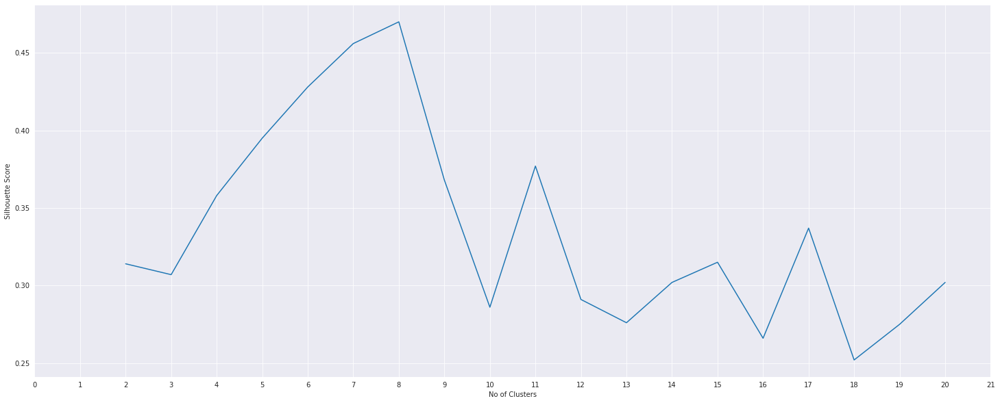

In [ ]:
plt.figure(figsize=(25,10))
sns.lineplot(x = Kmeans['No of Clusters'], y = Kmeans['Silhouette Score'])
plt.xticks(ticks = np.arange(0,22,1))

In [ ]:
Kmeans.sort_values(['Silhouette Score','No of Clusters'],ascending=False).head()

,No of Clusters,Silhouette Score
6,8,0.470
5,7,0.456
4,6,0.428
3,5,0.395
9,11,0.377


Key Insights
* The highest silhouette score is 0.474 & produced with 8 Clusters using K-Means Clustering Algorithm

##### Using Elbow Method to determine the Optimal number of Clusters

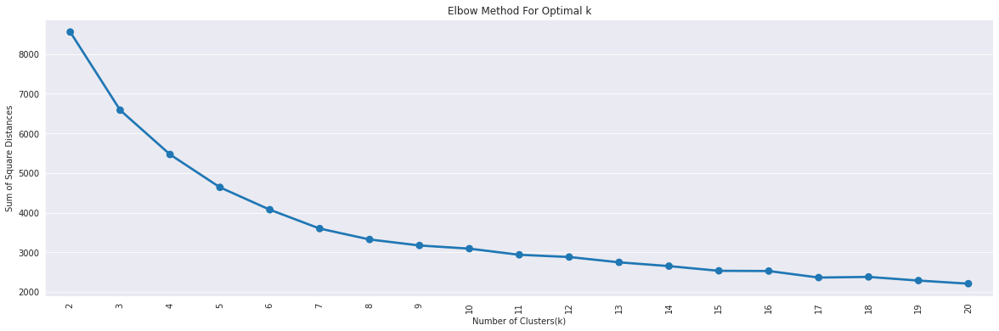

In [ ]:
#Plot the graph for the sum of square distance values and Number of Clusters
plt.figure(figsize=(20,6))
sns.pointplot(x = list(sum_of_sq_dist.keys()), y = list(sum_of_sq_dist.values()))
plt.xlabel('Number of Clusters(k)')
plt.ylabel('Sum of Square Distances')
plt.title('Elbow Method For Optimal k')
plt.xticks(rotation = 90)
plt.show()

Key Insights
* From the above graph has plots of the sum squared inertia for K clusters trained on K means algorithm.
* In this graph, we decide the optimal number of clusters by locating the elbow of the graph which is at 8 clusters.



##### Displaying Silhouette plot for K-means Clustering Algorithm

For n_clusters = 2 The average silhouette_score is : 0.313581254958346
For n_clusters = 3 The average silhouette_score is : 0.3072915955791883
For n_clusters = 4 The average silhouette_score is : 0.3577525496437915
For n_clusters = 5 The average silhouette_score is : 0.3945043064882987
For n_clusters = 6 The average silhouette_score is : 0.42761947760409097
For n_clusters = 7 The average silhouette_score is : 0.45603071335890827
For n_clusters = 8 The average silhouette_score is : 0.47042572577442177
For n_clusters = 9 The average silhouette_score is : 0.3682244241880697
For n_clusters = 10 The average silhouette_score is : 0.28635337954368506
For n_clusters = 11 The average silhouette_score is : 0.37724362494214675
For n_clusters = 12 The average silhouette_score is : 0.29081555312190044
For n_clusters = 13 The average silhouette_score is : 0.2756908092425472
For n_clusters = 14 The average silhouette_score is : 0.3017258653524748
For n_clusters = 15 The average silhouette_score is : 

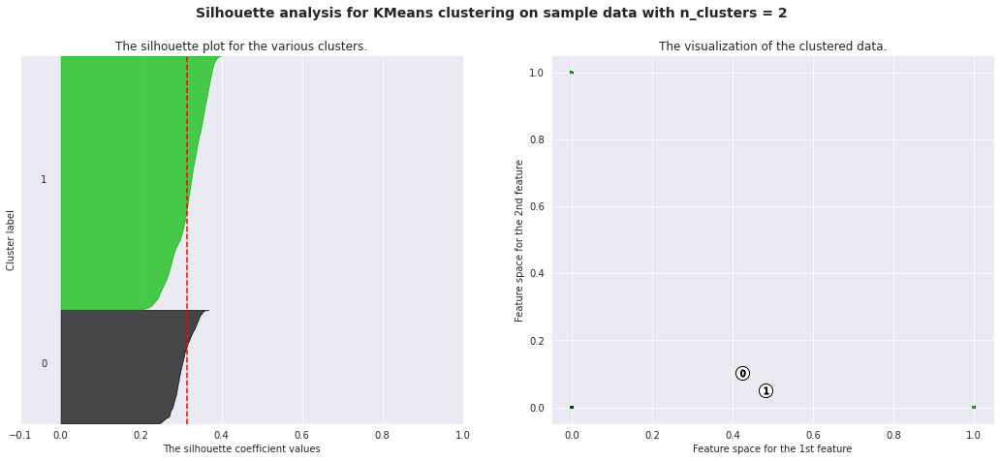

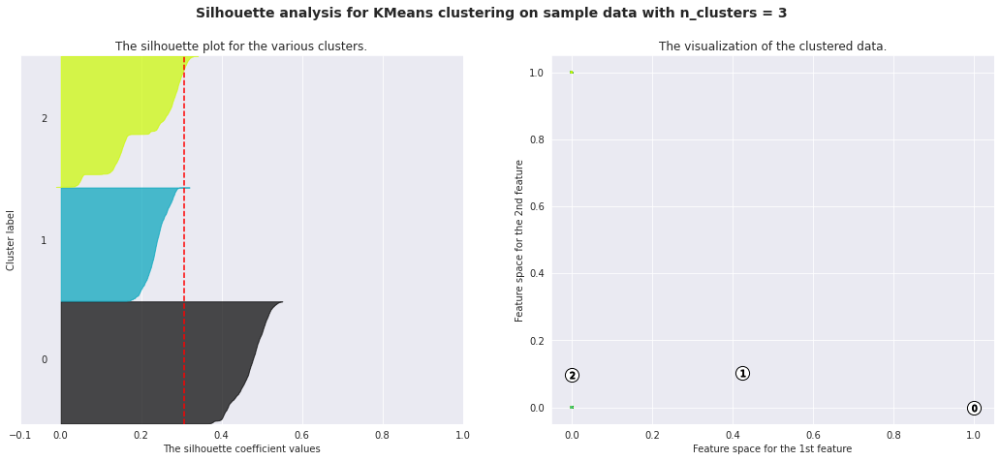

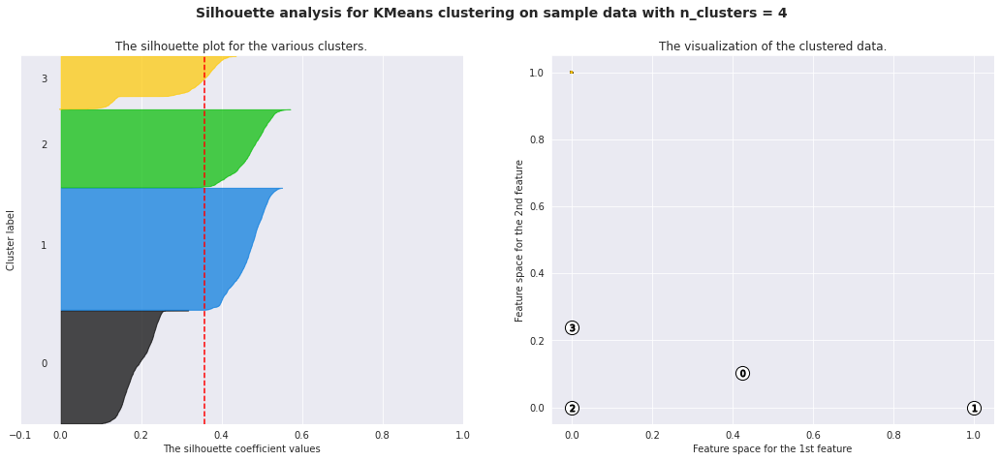

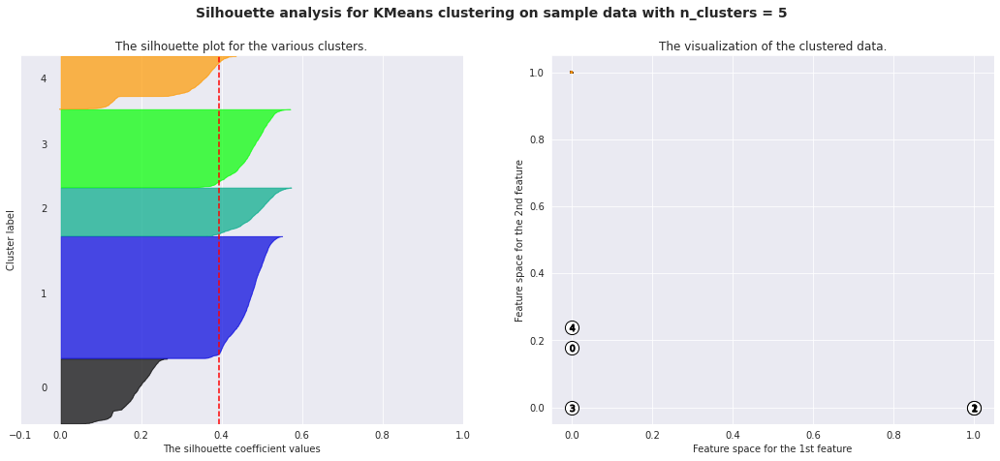

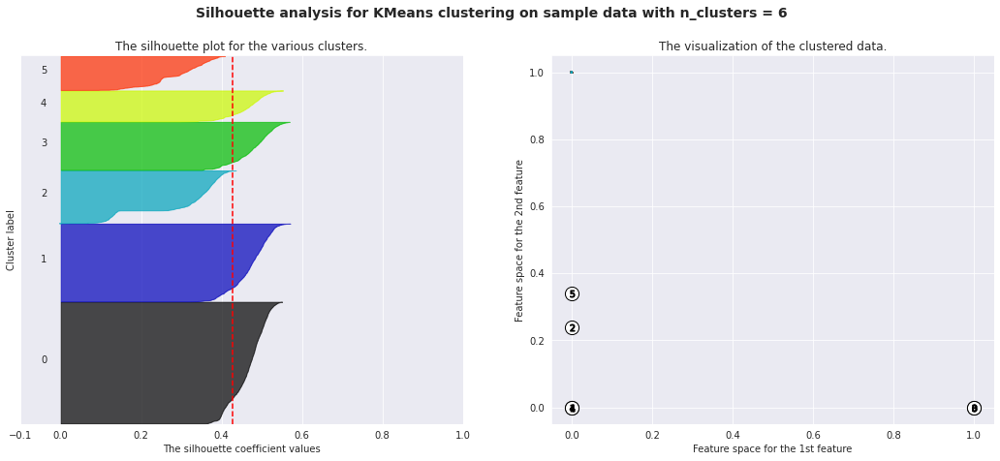

...

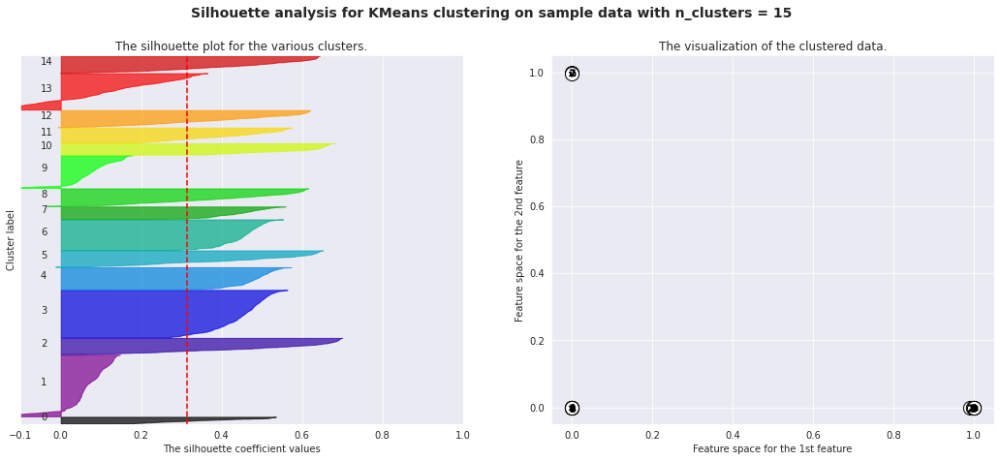

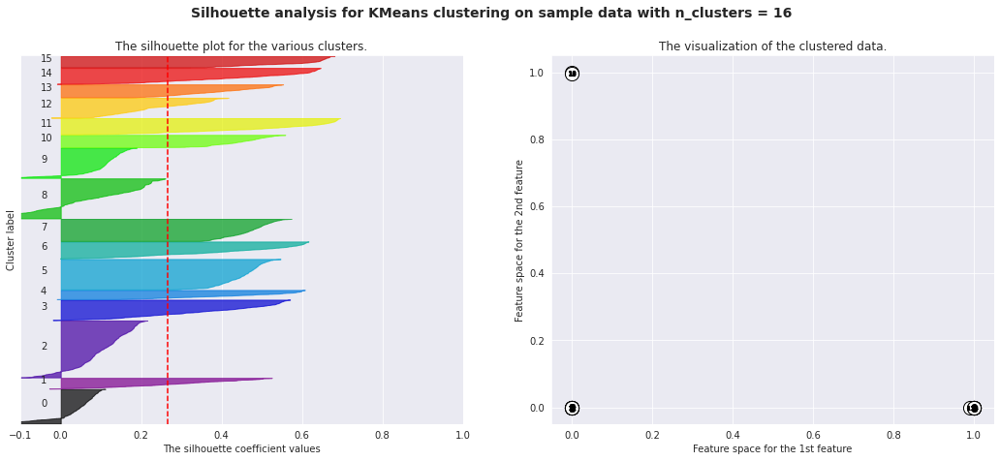

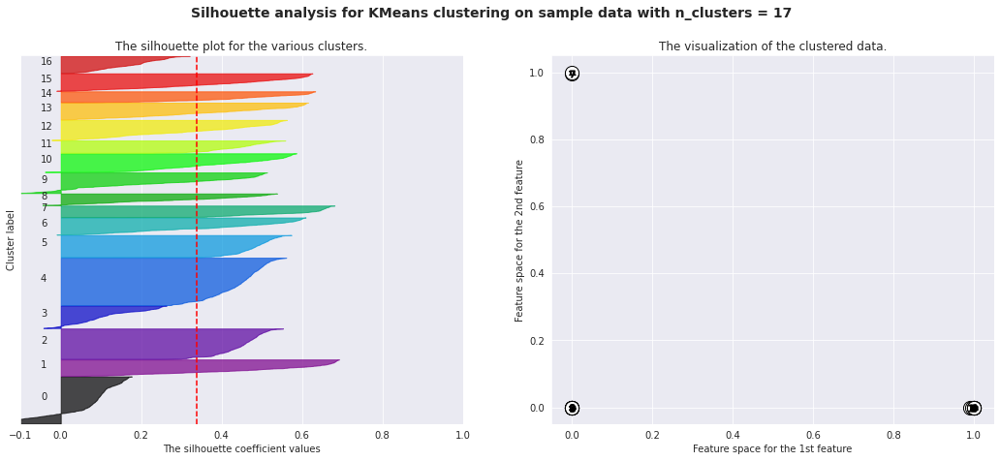

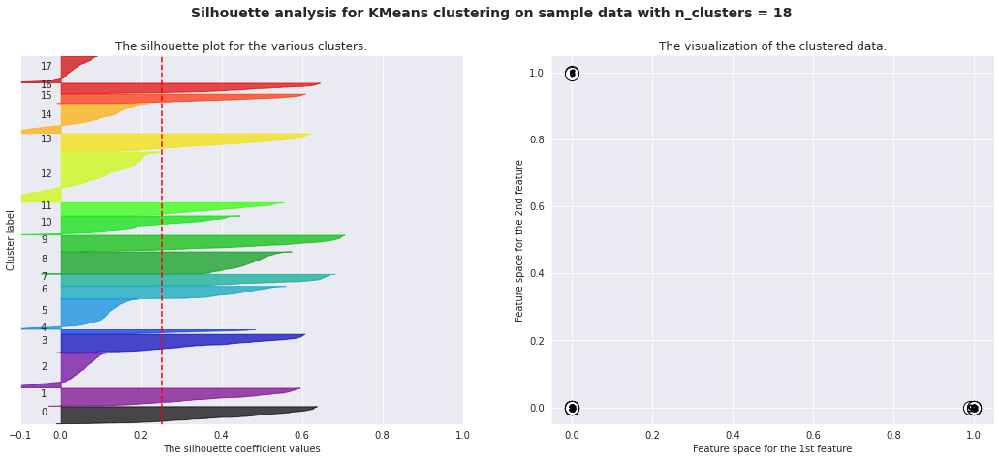

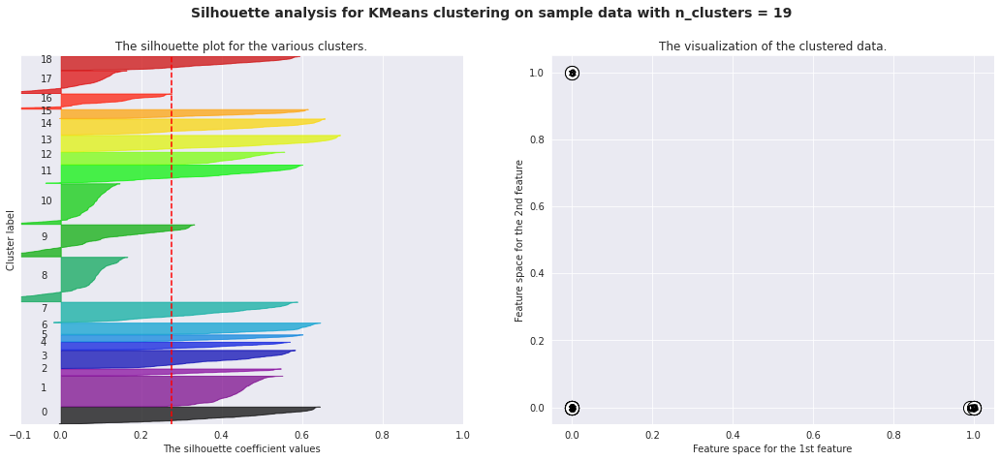

In [ ]:
n_clusters_range = [i for i in range(2,20)]
silhouette_score_ = []
for n_clusters in n_clusters_range :
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples. This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(f"For n_clusters = {n_clusters}" , f"The average silhouette_score is : {silhouette_avg}") # Use F string To print the value of n-cluster & silhouette average

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) /n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7, c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o', c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1, s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")
    plt.suptitle((f"Silhouette analysis for KMeans clustering on sample data with n_clusters = {n_clusters}"), fontsize=14, fontweight='bold') # Use F string To print the value of n-cluster

plt.show()

Key Insights
* From Silhouette Analysis and Elbow method, the optimal cluster is 9. This gives a clustering score of 0.354

Visualisation For k = 8 Clusters

For visualization, we're taking three significant components using PCA and plotting them 2 the front,side and top view of the 3d space. This way we can see how the clusters are arranged spatially.

In [ ]:
clusterer = KMeans(n_clusters= 8, n_init=10,random_state=10)
preds = clusterer.fit_predict(X)

In [ ]:
update_report('KMeans','Default' ,pd.Series(preds).nunique(), silhouette_score(X,preds), davies_bouldin_score(X,preds), calinski_harabasz_score(X,preds))

In [ ]:
predictions = pd.DataFrame(preds, columns = ['Clusters'])

In [ ]:
# Dimensionality reduction using PCA
from sklearn.decomposition import PCA
pca = PCA(n_components = 3)

In [ ]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
kmeans_cluster = pd.concat([reduced, predictions], axis=1)

In [ ]:
#setting colors for all visualisations
colors_list = " #000000 dimgray #696969 silver #c0c0c0 darkslategray #2f4f4f darkolivegreen #556b2f olivedrab #6b8e23 sienna #a0522d seagreen #2e8b57 forestgreen #228b22 maroon2 #7f0000 midnightblue #191970 darkgreen #006400 olive #808000 darkslateblue #483d8b firebrick #b22222 lightslategray #778899 mediumseagreen #3cb371 rosybrown #bc8f8f rebeccapurple #663399 darkgoldenrod #b8860b darkkhaki #bdb76b darkcyan #008b8b steelblue #4682b4 chocolate #d2691e yellowgreen #9acd32 darkblue #00008b indigo #4b0082 limegreen #32cd32 darkseagreen #8fbc8f darkmagenta #8b008b maroon3 #b03060 mediumturquoise #48d1cc mediumaquamarine #66cdaa darkorchid #9932cc orangered #ff4500 orange #ffa500 gold #ffd700 yellow #ffff00 mediumvioletred #c71585 mediumblue #0000cd burlywood #deb887 chartreuse #7fff00 lime #00ff00 mediumorchid #ba55d3 springgreen #00ff7f darksalmon #e9967a crimson #dc143c aqua #00ffff deepskyblue #00bfff sandybrown #f4a460 mediumpurple #9370db blue #0000ff purple3 #a020f0 lightcoral #f08080 greenyellow #adff2f tomato #ff6347 thistle #d8bfd8 fuchsia #ff00ff palevioletred #db7093 khaki #f0e68c laserlemon #ffff54 cornflower #6495ed plum #dda0dd lightgreen #90ee90 lightblue #add8e6 deeppink #ff1493 mediumslateblue #7b68ee violet #ee82ee lightskyblue #87cefa aquamarine #7fffd4 lightgoldenrod #fafad2 hotpink #ff69b4 mistyrose #ffe4e1 lightcyan #e0ffff pink #ffc0cb"
colors = [color for color in colors_list.split(' ') if '#' in color]

#looping to shuffle colors
np.random.seed(151203)
shuffled = []
while len(colors)!=0:
  a = np.random.choice(colors)
  shuffled.append(a)
  colors.remove(a)


gyr = shuffled[:pd.Series(preds).nunique()]

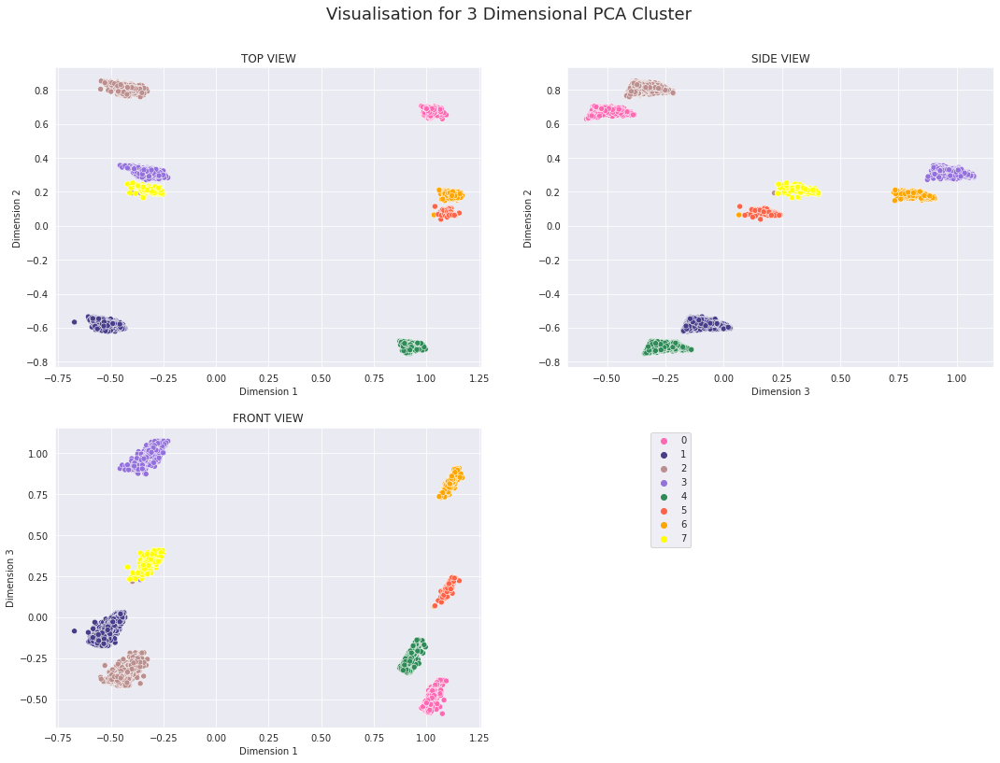

In [ ]:
from matplotlib import transforms
plt.figure(figsize=(18,13))
plt.suptitle("Visualisation for 3 Dimensional PCA Cluster", fontsize=18, y=0.95)

plt.subplot(2,2,1)
plt.title('TOP VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr), legend=False)

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5", 6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11", 12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5", 6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11", 12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr))
plt.legend(bbox_to_anchor=(1.5,1))

#### Hierarchical Clustering

Hierarchical clustering is a method of cluster analysis that seeks to build a hierarchy of clusters. It is most popular and widely used method to analyze social network data. In this method, nodes are compared with one another based on their similarity. Larger groups are built by joining groups of nodes based on their similarity.

In [ ]:
# import cluster.hierarchy for Hierarchical Clustering
import scipy.cluster.hierarchy as sch
hier_ward_euc = sch.linkage(X, method = 'ward', metric = 'euclidean')

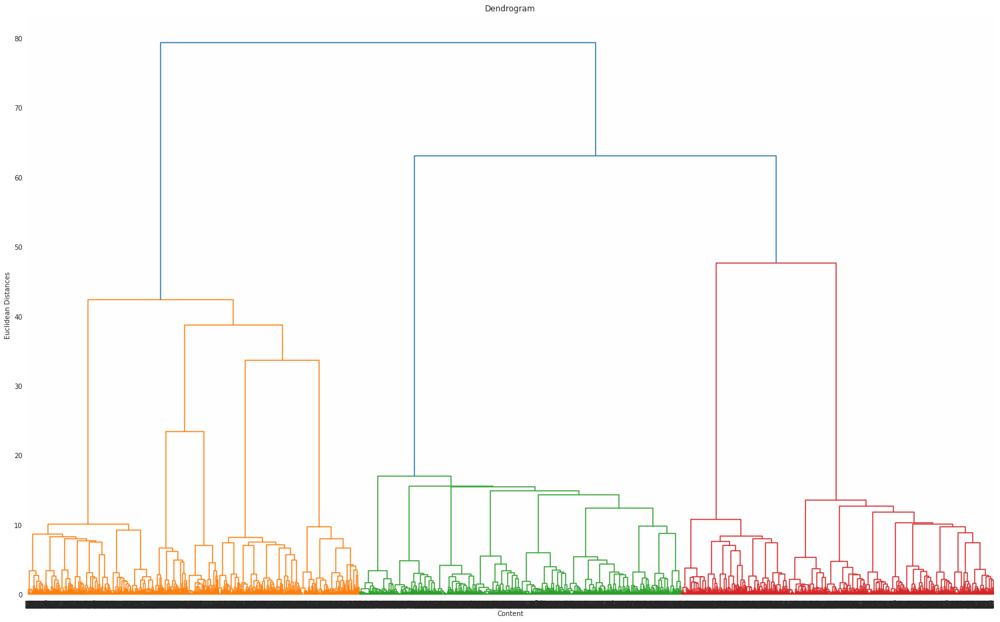

In [ ]:
# Dendrogram Visualisation for find largest vertical distance we can make without crossing any other horizontal line
plt.figure(figsize=(26,16))
dendrogram = sch.dendrogram(hier_ward_euc)
plt.title('Dendrogram')
plt.xlabel('Content')
plt.ylabel('Euclidean Distances')
plt.show() 


From Our Visualisation, a Distance Of 20-30 appears to have well defined trees.

Agglomerative Clustering

In [ ]:
clusters_list = []
scores_list = []
distances_list = []
for i in np.arange(5,75,5):
  hc = AgglomerativeClustering(n_clusters = None, distance_threshold = i, affinity = 'euclidean', linkage = 'ward')
  y_hc = hc.fit_predict(X)
  clusters_list.append(hc.labels_.max()+1)
  if (hc.labels_.max()+1 >=2) :
    scores_list.append(silhouette_score(X, y_hc))
  else:
    scores_list.append(1)
  distances_list.append(i)

hierarchical_data = pd.DataFrame({'Clusters': clusters_list, 'Silhouette Scores': scores_list, 'Distance': distances_list})

([<matplotlib.axis.XTick at 0x7fae5912de50>,
 <a list of 70 Text major ticklabel objects>)

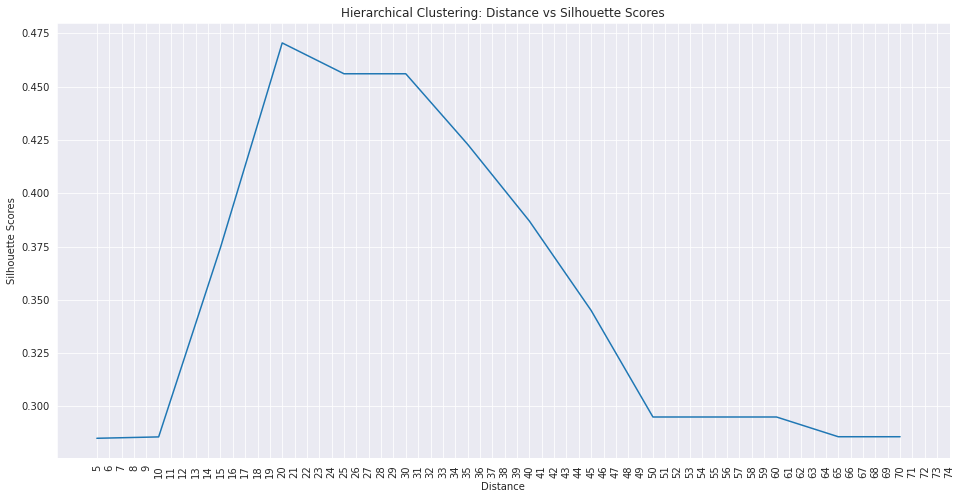

In [ ]:
# Visualisation Distance vs Silhouette Score Graph For Hierarchical Clustering.
plt.figure(figsize =(16,8))
sns.lineplot(x = 'Distance', y = 'Silhouette Scores' , data = hierarchical_data)
plt.title('Hierarchical Clustering: Distance vs Silhouette Scores')
plt.xticks(np.arange(5,75,1),rotation = 90)

In [ ]:
# Checking Distance-Silhouette Score-Clusters Table for Hierarchical Clustering.
hierarchical_data.sort_values('Silhouette Scores', ascending = False).head()

,Clusters,Silhouette Scores,Distance
3,8,0.470549,20
4,7,0.456085,25
5,7,0.456085,30
6,6,0.423027,35
7,5,0.387004,40


Key Insights
* Highest Silhouette Score of 0.4705 achieved at distance = 20 with 8 clusters.

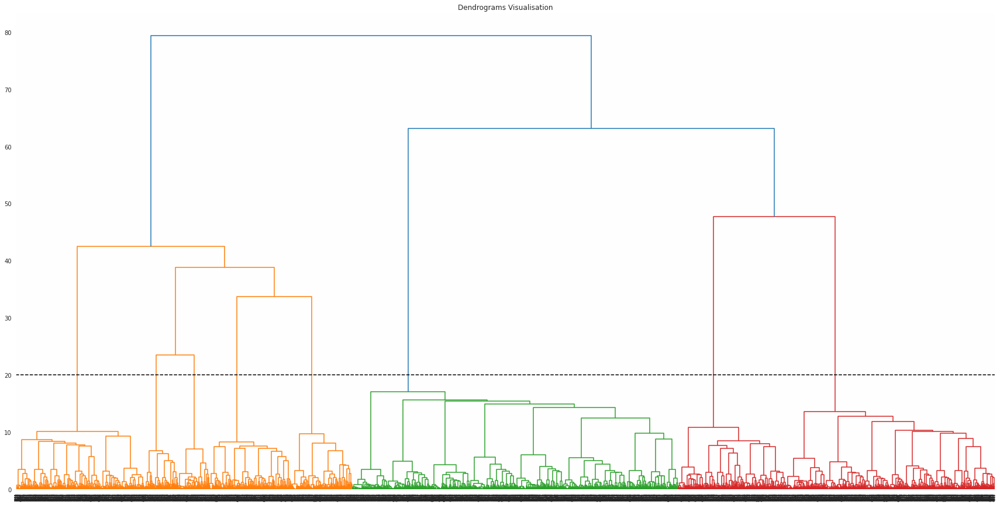

In [ ]:
# Dendrogram Visualisation for find largest vertical distance we can make without crossing any other horizontal line
plt.figure(figsize =(30,15))
plt.title("Dendrograms Visualisation")  
dend = sch.dendrogram(sch.linkage(X, method='ward'))
plt.axhline(y= 20, color='black', linestyle='--')

Visualisation for Distance = 20

For Our visualisation, we're taking three significant components using PCA and plotting them 2 the front,side and top view of the 3d space. This way we can see how the clusters are arranged spatially. 

In [ ]:
h_clustering = AgglomerativeClustering(n_clusters = None, distance_threshold = 20, affinity = 'euclidean', linkage = 'ward')
preds = h_clustering.fit_predict(X)

update_report('Hierarchical Agglomerative','Distance = 20' ,pd.Series(preds).nunique(), silhouette_score(X,preds), davies_bouldin_score(X,preds), calinski_harabasz_score(X,preds))
predictions = pd.DataFrame(preds, columns = ['Labels'])

# Dimensionality reduction using PCA
pca = PCA(n_components = 3)
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
hierarchical_cluster = pd.concat([reduced, predictions], axis=1)

In [ ]:
colors = shuffled[:pd.Series(hc.labels_).nunique()]

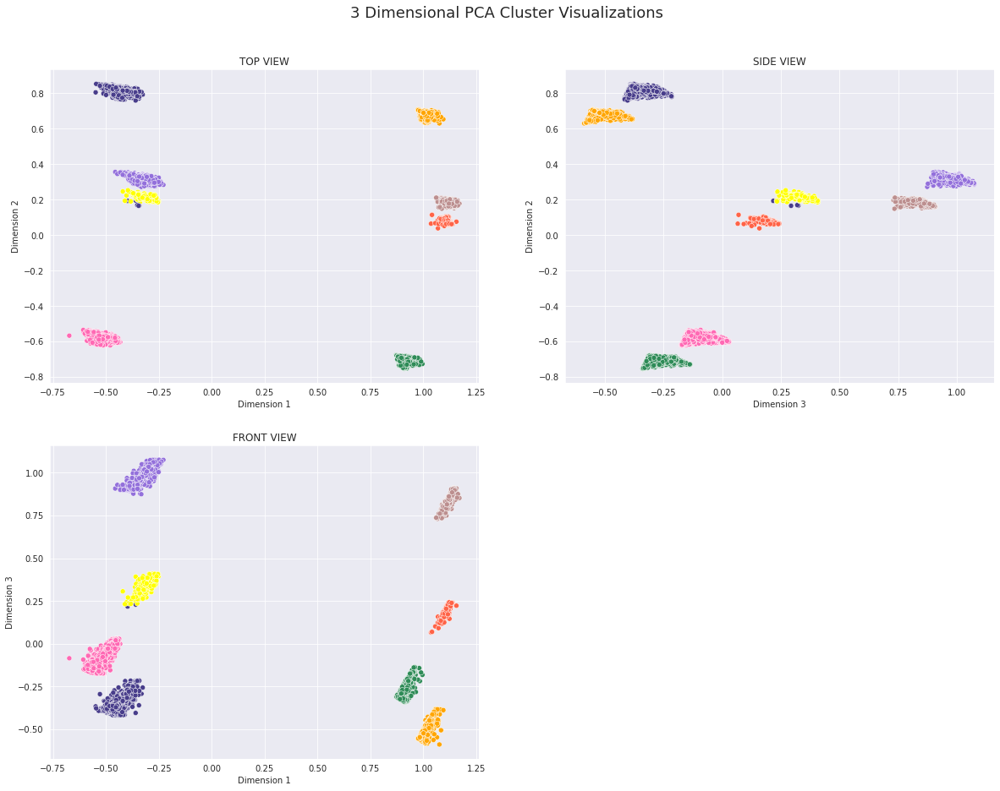

In [ ]:
# Visualisation of 3 Dimensional PCA Cluster Visualizations
plt.figure(figsize=(20,15))
plt.suptitle("3 Dimensional PCA Cluster Visualizations", fontsize=18, y=0.95)

plt.subplot(2,2,1)
plt.title('TOP VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = hierarchical_cluster, hue = 'Labels',palette = sns.color_palette(colors), legend=False)

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2',  data = hierarchical_cluster, hue = 'Labels',palette = sns.color_palette(colors), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = hierarchical_cluster, hue = 'Labels',palette = sns.color_palette(colors), legend=False)

After Optimizing and Selecting the Best Number of Clusters for the Three Models, the Final Report is Displayed Down Below.

In [ ]:
pd.DataFrame(clustering_report)

,Algorithm,Parameters,Clusters,Silhouette Coefficient,Davies-Bouldin Index,Calinski-Harbaz Score
0,DBSCAN,Default,9,0.468302,1.617649,2538.137264
1,KMeans,Default,8,0.470426,0.884662,2932.283775
2,Hierarchical Agglomerative,Distance = 20,8,0.470549,0.883982,2930.849722


#### Conclusion

* 1) After Visualise Total Release Movies/Tv shows in Last 10 years, we find out :- 
        i) 2018 is a year where Maximum number of movies have been released which is Total 1121. 
       ii) 2017 is a Secound Highest year For Maximum number of movies have been released which is Total 1012.
      iii) 2019 is a Third Highest year where 996 number of movies have been released.
* 2)  
      69% are Movie type of Contents on Netflix which is Total 5377 Number of Movies.
      31% are TV Show type of Contents on Netflix which is Total 2410 Number of TV Shows.
* 3)  
      i) United State is a Country which is produced Highest Number of Movies/Shows on Netflix. Total Number  
           of  Movies/Show produced by US is 3296.
      ii) India is a Second Highest Country which is produced Highest Number of Movies/Shows on Netflix. Total 
           Number of Movies/Show produced by India is 990.
      iii) United Kingdom is a Third Highest Country which is produced Highest Number of Movies/Shows on
           Netflix. Total Number of Movies/Show produced by US is 722.
* 4)  
      i) Tv-MA is a Highest Rating Distribution For Movies and Shows on Netflix, which is Total 2863.
      ii) Tv-14 is a Secound Highest Rating Distribution For Movies and Shows on Netflix, which is Total 1931.
      iii) Tv-PG is a Third Highest Rating Distribution For Movies and Shows on Netflix, which is Total 806.
* 5)    
       i) Drama is a Top Genres For Movies/TV Shows on Netflix. That is, the content of the movie in the drama genre has been produced the most which is 2810 Times.
       ii)  Comedy is a Secound Highest Genres For Movies/TV Shows on Netflix which is 2377 Times.
      iii)  Documentary is a Third Highest Genres For Movies/TV Shows on Netflix which is 1139 Times.
      iv)  Action_Adventure are in 4th Position & Romance are in 5th Position.
* 6)  
       i)  Jan Suter is the top director in the Netflix industry & he has Directed 21 Movies/Shows.
      ii)  Raul Compose is the Second top director in the Netflix industry & he has Directed 19 Movies/Shows.
      iii)  Marcus Raboy is the Third top director in the Netflix industry & he has Directed 16 Movies/Shows.
      iv)  Jay Karas is the 4th position & he has Directed 15 Movies/Shows and Cathy Garcia-Molina is the 5th Position & he has Directed 13 Movies/Shows.
* 7) 
      i) Anupam Kher is the Top Cast on Netflix As Our Visualisation.
      ii) Shah Rukh Khan is the second highest cast on Netflix.
      iii) Naseeruddin Shah is the third highest cast on Netflix.
      iv) Om Puri is the 4th Highest cast on Netflix.
      v) Akshay Kumar is the 5th Highest cast on Netflix.
* 8 )  
      Most of the movies on Netflix have a duration range from 85 to 115 minutes.
* 9 )   
      Most TV shows on Netflix have a length of 1 season only.
* 10)  
      i) Drama is the most produced genre in a lot of Non-English speaking countries.
       ii) Comedy is the most produced genre in English speaking countries like United States of America and        
          United Kingdom and Canada.
      iii) Drama and Comedy are the most produced genres in the top countries with exceptions of Japan and       
          South Korea.
      iv) Japan is the biggest producer of Anime. Anime is also the most produced in genre in Japan.
       v) Most South Korean content are from the Romance genre.
      vi) Documentaries are mainly produced in United Kingdom and United States of America.
* 11) 
       i) The above graph depicts seasons of TV shows signed vs the movies signed.
      ii) This distinction gives contacts as TV shows require recurring investment for each seasons. So the TV numbers have been increased in accordance to the seasons. As they were considered as one entity earlier. 
      iii) We can observe that TV shows signed have been higher than movies in 2016. While the the movies signed have been higher, it is blatantly visible that the TV shows signed per year is catching up to the movies signed by the year.
* 12) 
      After Performing DBSCAN clustered the data into 10 clusters with a silhouette score is 0.43875.
13 )   
      After Performing K-means Clustering  the elbow and optimal silhouette score were found at 8 clusters with a silhouette score of 0.474, Davies-Bouldin Index of 0.884 and Calinski-Harbaz Score of 2932.28.
14)   
      After Performing Hierarchical Clustering the dendrogram distance was optimal at a distance of 20 with eight clusters producing a silhouette score of 0.4705, Davies-Bouldin Index of 0.8839 and Calinski-Harbaz Score of 2930.84



  



<center>  **Thank You**